# Exploratory Data Analysis, Data Preprocessing, Modeling

## Importing the datasets and library


In [26]:
# Import Statements

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

import string
import regex as re
import spacy

from nltk.corpus import stopwords
# nltk.download('stopwords')
# nltk.download('punkt')
from nltk import word_tokenize
from nltk import FreqDist

import warnings
warnings.filterwarnings('ignore')

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.naive_bayes import MultinomialNB, GaussianNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import recall_score, accuracy_score, f1_score, confusion_matrix, classification_report
from sklearn.utils import class_weight
from sklearn.pipeline import Pipeline
from sklearn.base import TransformerMixin
from sklearn import set_config

from PIL import Image
from wordcloud import WordCloud
from textwrap import wrap

import joblib
import pickle


In [27]:
# Read in the DataFrame I created in the Data Collection notebook 
df = pd.read_csv('..\Data\cities_df', index_col=0)
df.head()


,Attraction,City
0,SEA LIFE London Aquarium Admission Ticket,"London, United Kingdom"
1,The Jack The Ripper Walking Tour in London,"London, United Kingdom"
2,Ghost Bus Tour of London,"London, United Kingdom"
3,Big Bus London Hop-On Hop-Off Tour and River C...,"London, United Kingdom"
4,The Blood and Tears Walk: Serial Killers and L...,"London, United Kingdom"


In [28]:
df.describe()

,Attraction,City
count,28379,28379
unique,27466,12
top,Desert Safari Dubai,"Bali, Indonesia"
freq,15,5000


## Explore /clean the data

- Decide whether or not to get rid of duplicates
- Check out the class imbalance

In [29]:
#No null values because I scraped everything myself. Just to double-check:
df.isna().sum()

Attraction    0
City          0
dtype: int64

In [30]:
df.duplicated().sum()

846

In [31]:
# Look at duplicates in one city
df[(df.duplicated()==True) & (df['City']=='London, United Kingdom')]

,Attraction,City
185,"Windsor Castle, Stonehenge, and Oxford Day Tri...","London, United Kingdom"
241,Jack the Ripper Walking Tour in London,"London, United Kingdom"
259,British Museum Guided Tour,"London, United Kingdom"
618,Private Transfer from Heathrow Airport to London,"London, United Kingdom"
704,Oxford City Full-Day Private Tour from London,"London, United Kingdom"
705,Bath and Stonehenge Full-Day Private Tour from...,"London, United Kingdom"
706,Full-Day Private Guided Tour of Cambridge,"London, United Kingdom"
716,Full-Day Private Tour of Brighton,"London, United Kingdom"
900,PRIVATE Jack the Ripper Ghost Walking Tour in ...,"London, United Kingdom"
990,London to Southampton Cruise Terminals Private...,"London, United Kingdom"


In [32]:
df[df['Attraction']=='Oxford City Full-Day Private Tour from London']

,Attraction,City
431,Oxford City Full-Day Private Tour from London,"London, United Kingdom"
704,Oxford City Full-Day Private Tour from London,"London, United Kingdom"


In [33]:
# What about the top attraction?
df[df['Attraction']=='Desert Safari Dubai']

,Attraction,City
414,Desert Safari Dubai,"Dubai, United Arab Emirates"
478,Desert Safari Dubai,"Dubai, United Arab Emirates"
811,Desert Safari Dubai,"Dubai, United Arab Emirates"
974,Desert Safari Dubai,"Dubai, United Arab Emirates"
998,Desert Safari Dubai,"Dubai, United Arab Emirates"
1001,Desert Safari Dubai,"Dubai, United Arab Emirates"
1689,Desert Safari Dubai,"Dubai, United Arab Emirates"
1718,Desert Safari Dubai,"Dubai, United Arab Emirates"
1722,Desert Safari Dubai,"Dubai, United Arab Emirates"
1944,Desert Safari Dubai,"Dubai, United Arab Emirates"


We need to be deleting duplicates based on it

In [34]:
df = df.drop_duplicates()

### Class imbalance

In [35]:
display(df.City.unique())
print('Total Unique Cities:', len(df.City.unique()))

array(['London, United Kingdom', 'Paris, France', 'Crete, Greece',
       'Bali, Indonesia', 'Rome, Italy', 'Phuket, Thailand',
       'Sicily, Italy', 'Majorca, Balearic Islands', 'Barcelona, Spain',
       'Istanbul, Turkey', 'Goa, India', 'Dubai, United Arab Emirates'],
      dtype=object)

Total Unique Cities: 12


In [36]:
df.City.value_counts(normalize=True)

City
Bali, Indonesia                0.177823
Rome, Italy                    0.174990
Dubai, United Arab Emirates    0.123597
London, United Kingdom         0.099626
Paris, France                  0.096938
Istanbul, Turkey               0.081248
Sicily, Italy                  0.071986
Barcelona, Spain               0.066502
Phuket, Thailand               0.041260
Crete, Greece                  0.037010
Majorca, Balearic Islands      0.016489
Goa, India                     0.012530
Name: proportion, dtype: float64

In [37]:
cities = df.groupby('City').count()

In [38]:
cities.reset_index(inplace=True)

In [39]:
sorted_cities = cities.sort_values(by='Attraction', ascending=False)
sorted_cities

,City,Attraction
0,"Bali, Indonesia",4896
10,"Rome, Italy",4818
3,"Dubai, United Arab Emirates",3403
6,"London, United Kingdom",2743
8,"Paris, France",2669
5,"Istanbul, Turkey",2237
11,"Sicily, Italy",1982
1,"Barcelona, Spain",1831
9,"Phuket, Thailand",1136
2,"Crete, Greece",1019


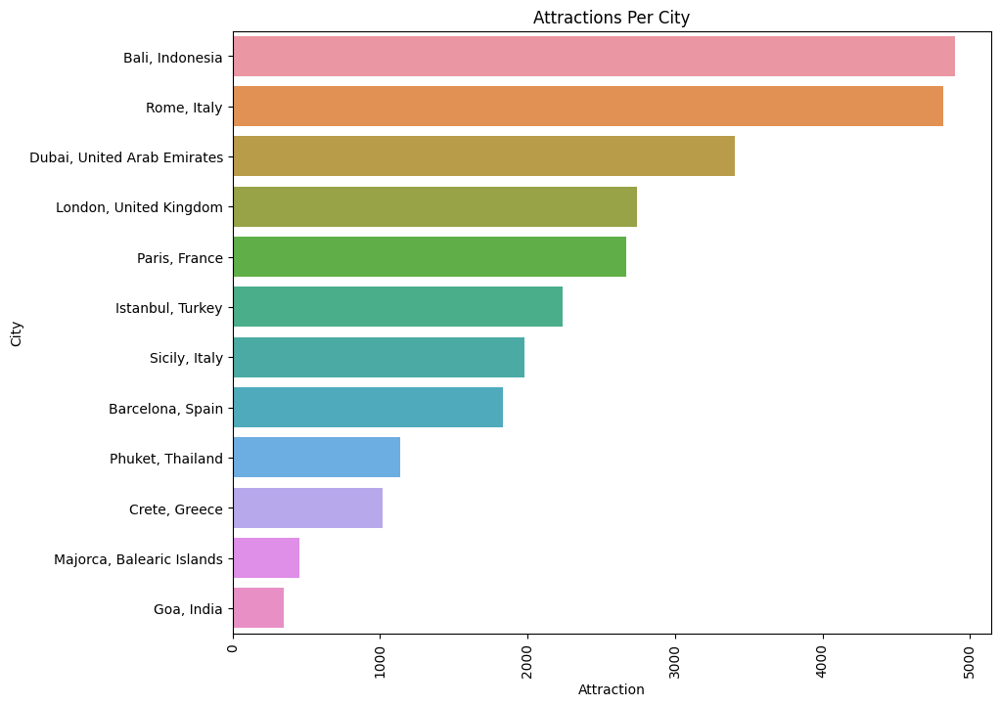

In [40]:
# Plot the class imbalance
plt.figure(figsize=(10,8))
sns.barplot(x='Attraction', y='City', data=sorted_cities)
plt.title('Attractions Per City')
plt.xticks(rotation=90)
plt.show()

### Text Cleaning & Preprocessing & More Exploration
- Remove punctuation and numbers
- Lowercase everything
- Remove stopwords
- Create a document term matrix grouped by city 
    - count vectorization
    - tf-idf vectorization
    - bi-grams
- Visualize most frequent words
    - word clouds
    - bar plot/histogram

In [41]:
# Create a list of stopwords
stopwords_list = stopwords.words('english')
stopwords_list += list(string.punctuation)

In [42]:
# Preview the list
stopwords_list[:5]

['i', 'me', 'my', 'myself', 'we']

In [43]:
# Save stopwords list for app
joblib.dump(stopwords_list, '../Data/stopwords_list')

['../Data/stopwords_list']

In [44]:
# Lowercase all words in each corpus
df['cleaned'] = df['Attraction'].apply(lambda x: x.lower())
df.head()

,Attraction,City,cleaned
0,SEA LIFE London Aquarium Admission Ticket,"London, United Kingdom",sea life london aquarium admission ticket
1,The Jack The Ripper Walking Tour in London,"London, United Kingdom",the jack the ripper walking tour in london
2,Ghost Bus Tour of London,"London, United Kingdom",ghost bus tour of london
3,Big Bus London Hop-On Hop-Off Tour and River C...,"London, United Kingdom",big bus london hop-on hop-off tour and river c...
4,The Blood and Tears Walk: Serial Killers and L...,"London, United Kingdom",the blood and tears walk: serial killers and l...


In [45]:
# Remove commas, hyphens, colons, and other punctuation
df['cleaned'] = df['cleaned'].apply(lambda x: re.sub('[%s]' % re.escape(string.punctuation), '', x))
df.head()

,Attraction,City,cleaned
0,SEA LIFE London Aquarium Admission Ticket,"London, United Kingdom",sea life london aquarium admission ticket
1,The Jack The Ripper Walking Tour in London,"London, United Kingdom",the jack the ripper walking tour in london
2,Ghost Bus Tour of London,"London, United Kingdom",ghost bus tour of london
3,Big Bus London Hop-On Hop-Off Tour and River C...,"London, United Kingdom",big bus london hopon hopoff tour and river cru...
4,The Blood and Tears Walk: Serial Killers and L...,"London, United Kingdom",the blood and tears walk serial killers and lo...


In [46]:
# Use regex to get rid of numbers 
df['cleaned'] = df['cleaned'].apply(lambda x: re.sub('\w*\d\w*','', x))
df.head(10)

,Attraction,City,cleaned
0,SEA LIFE London Aquarium Admission Ticket,"London, United Kingdom",sea life london aquarium admission ticket
1,The Jack The Ripper Walking Tour in London,"London, United Kingdom",the jack the ripper walking tour in london
2,Ghost Bus Tour of London,"London, United Kingdom",ghost bus tour of london
3,Big Bus London Hop-On Hop-Off Tour and River C...,"London, United Kingdom",big bus london hopon hopoff tour and river cru...
4,The Blood and Tears Walk: Serial Killers and L...,"London, United Kingdom",the blood and tears walk serial killers and lo...
5,London Ghost and Infamous Murders Walking Tour,"London, United Kingdom",london ghost and infamous murders walking tour
6,"Stonehenge, Windsor Castle, and Bath from London","London, United Kingdom",stonehenge windsor castle and bath from london
7,Warner Bros. Studio: The Making of Harry Potte...,"London, United Kingdom",warner bros studio the making of harry potter ...
8,"Ghosts, Ghouls & Gallows: London Virtual Tour","London, United Kingdom",ghosts ghouls gallows london virtual tour
9,High-Speed Thames River RIB Cruise in London,"London, United Kingdom",highspeed thames river rib cruise in london


In [47]:
# Lemmatize the text using spacy
nlp = spacy.load('en_core_web_sm')

df['lemmatized'] = df['cleaned'].apply(lambda x: ' '.join(
                                    [token.lemma_ for token in list(nlp(x)) if (token.is_stop==False)]))
df.head(10)

,Attraction,City,cleaned,lemmatized
0,SEA LIFE London Aquarium Admission Ticket,"London, United Kingdom",sea life london aquarium admission ticket,sea life london aquarium admission ticket
1,The Jack The Ripper Walking Tour in London,"London, United Kingdom",the jack the ripper walking tour in london,jack ripper walking tour london
2,Ghost Bus Tour of London,"London, United Kingdom",ghost bus tour of london,ghost bus tour london
3,Big Bus London Hop-On Hop-Off Tour and River C...,"London, United Kingdom",big bus london hopon hopoff tour and river cru...,big bus london hopon hopoff tour river cruise ...
4,The Blood and Tears Walk: Serial Killers and L...,"London, United Kingdom",the blood and tears walk serial killers and lo...,blood tear walk serial killer london horror
5,London Ghost and Infamous Murders Walking Tour,"London, United Kingdom",london ghost and infamous murders walking tour,london ghost infamous murder walk tour
6,"Stonehenge, Windsor Castle, and Bath from London","London, United Kingdom",stonehenge windsor castle and bath from london,stonehenge windsor castle bath london
7,Warner Bros. Studio: The Making of Harry Potte...,"London, United Kingdom",warner bros studio the making of harry potter ...,warner bros studio making harry potter luxury ...
8,"Ghosts, Ghouls & Gallows: London Virtual Tour","London, United Kingdom",ghosts ghouls gallows london virtual tour,ghosts ghoul gallow london virtual tour
9,High-Speed Thames River RIB Cruise in London,"London, United Kingdom",highspeed thames river rib cruise in london,highspeed thames river rib cruise london


In [48]:
# Group the corpora by city and join them
df_to_group = df[['City', 'lemmatized']]
df_grouped = df_to_group.groupby(by='City').agg(lambda x:' '.join(x))
df_grouped

,lemmatized
City,
"Bali, Indonesia",hotel hotelbali private transfer daytime bali ...
"Barcelona, Spain",interactive spanish cooking experience barcelo...
"Crete, Greece",minoans world museum cinema crete wine ol...
"Dubai, United Arab Emirates",premium red dune camel safari bbq al khayma ...
"Goa, India",fontainhas heritage walk sunset cruise paradis...
"Istanbul, Turkey",bosphorus sunset cruise luxury yacht istanbu...
"London, United Kingdom",sea life london aquarium admission ticket jack...
"Majorca, Balearic Islands",cave genova admission palma de mallorca shore ...
"Paris, France",bateaux parisien seine river gourmet dinner ...


In [49]:
# Save grouped df
df_grouped.to_csv('../Data/df_grouped')

## Vectorization 
- Try different vectorization strategies and visualize them with word clouds
    - count vectorization
    - tf-idf vectorization
    - bi-grams

In [50]:
# Create a document term matrix using count vectorization
# Using count vectorization (most simple way to vectorize)
cv = CountVectorizer(analyzer='word', stop_words=stopwords_list)
data = cv.fit_transform(df_grouped['lemmatized'])
df_dtm = pd.DataFrame(data.toarray(), columns=cv.get_feature_names_out())
df_dtm.index = df_grouped.index
df_dtm

,aal,abandon,abant,abba,abbate,abbey,abbeyprivate,abbeyst,aberfan,abian,...,تشيتا,خصوصي,دي,روما,فورميا,كاستيلوا,مدينة,من,ميرتيتوا,نقل
City,,,,,,,,,,,,,,,,,,,,,
"Bali, Indonesia",0,2,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
"Barcelona, Spain",1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Crete, Greece",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Dubai, United Arab Emirates",0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Goa, India",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Istanbul, Turkey",0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"London, United Kingdom",0,0,0,1,0,61,1,2,1,0,...,0,0,0,0,0,0,0,0,0,0
"Majorca, Balearic Islands",0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Paris, France",0,0,0,0,0,5,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [51]:
# Create a document term matrix using TF-IDF vectorization
# Might be good for classifying cities
tfidf = TfidfVectorizer(analyzer='word', stop_words=stopwords_list)
data2 = tfidf.fit_transform(df_grouped['lemmatized'])
df_dtm2 = pd.DataFrame(data2.toarray(), columns=tfidf.get_feature_names_out())
df_dtm2.index = df_grouped.index
df_dtm2

,aal,abandon,abant,abba,abbate,abbey,abbeyprivate,abbeyst,aberfan,abian,...,تشيتا,خصوصي,دي,روما,فورميا,كاستيلوا,مدينة,من,ميرتيتوا,نقل
City,,,,,,,,,,,,,,,,,,,,,
"Bali, Indonesia",0.000000,0.000699,0.000000,0.0000,0.000000,0.000000,0.0000,0.000000,0.0000,0.000407,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Barcelona, Spain",0.000737,0.000000,0.000000,0.0000,0.000000,0.000000,0.0000,0.000000,0.0000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Crete, Greece",0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.0000,0.000000,0.0000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Dubai, United Arab Emirates",0.000000,0.000309,0.000000,0.0000,0.000000,0.000000,0.0000,0.000000,0.0000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Goa, India",0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.0000,0.000000,0.0000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Istanbul, Turkey",0.000000,0.000000,0.000589,0.0000,0.000000,0.000000,0.0000,0.000000,0.0000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"London, United Kingdom",0.000000,0.000000,0.000000,0.0005,0.000000,0.023151,0.0005,0.001001,0.0005,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Majorca, Balearic Islands",0.000000,0.000000,0.000000,0.0000,0.003344,0.000000,0.0000,0.000000,0.0000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Paris, France",0.000000,0.000000,0.000000,0.0000,0.000000,0.002363,0.0000,0.000000,0.0000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


### Word Cloud with Count Vectorization

In [52]:
def generate_wordcloud(data, title):
    cloud = WordCloud(width=400, height=330, max_words=150, colormap='tab20c').generate_from_frequencies(data)
    plt.figure(figsize=(10,8))
    plt.imshow(cloud, interpolation='bilinear')
    plt.axis('off')
    plt.title('\n'.join(wrap(title,60)), fontsize=13)
    plt.show()

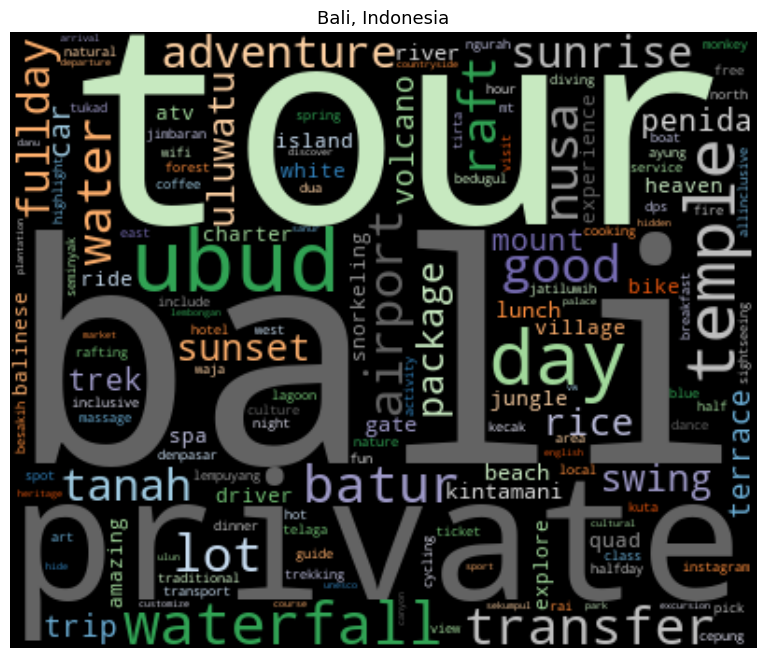

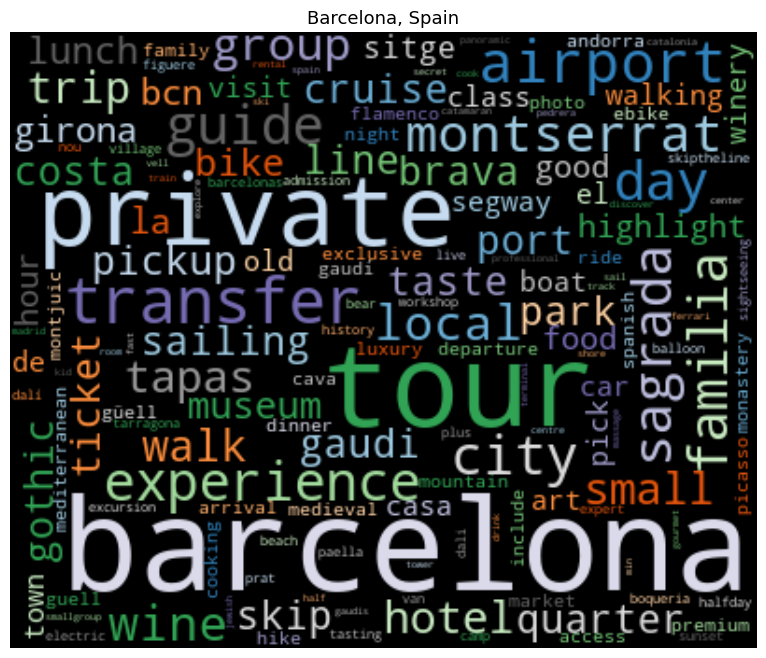

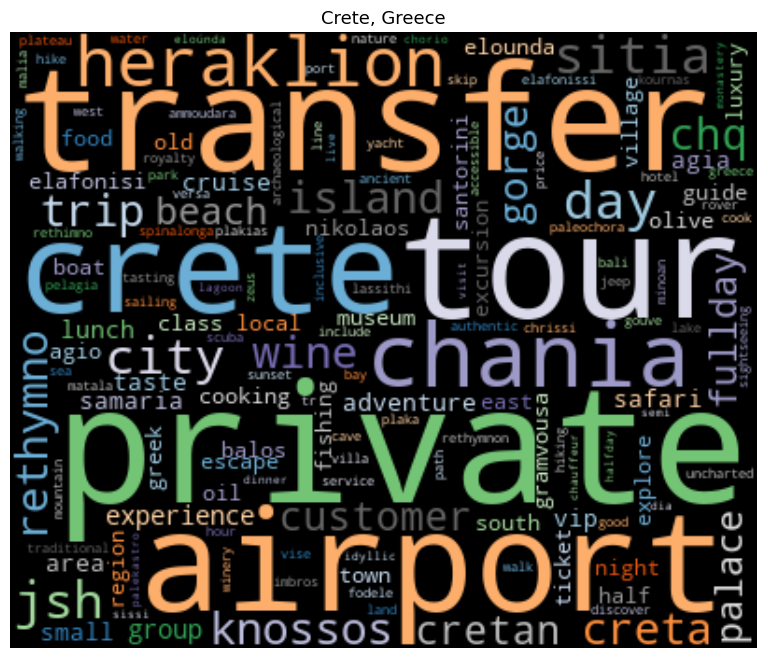

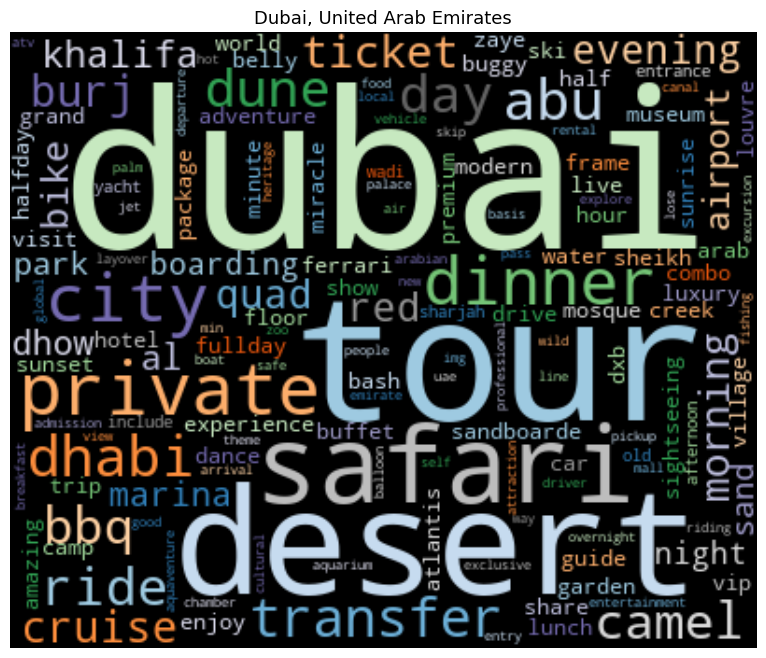

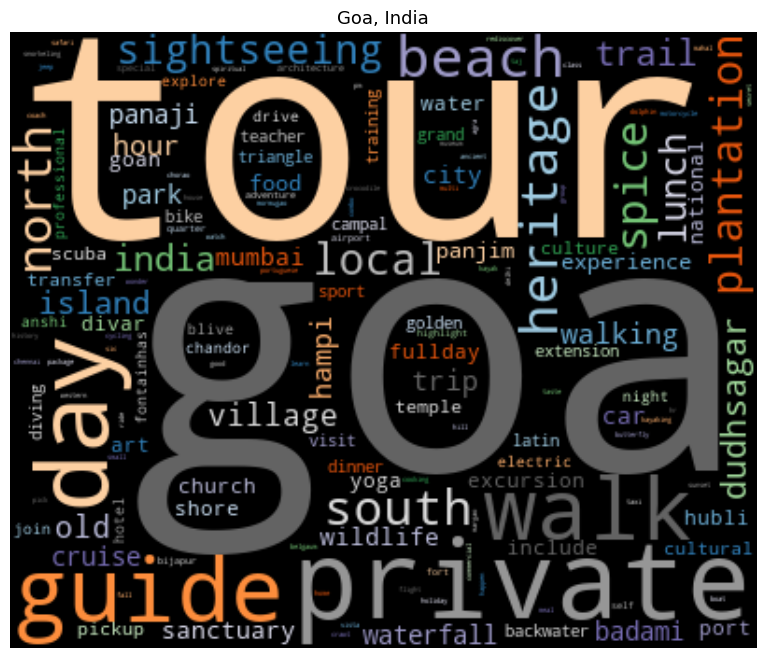

...

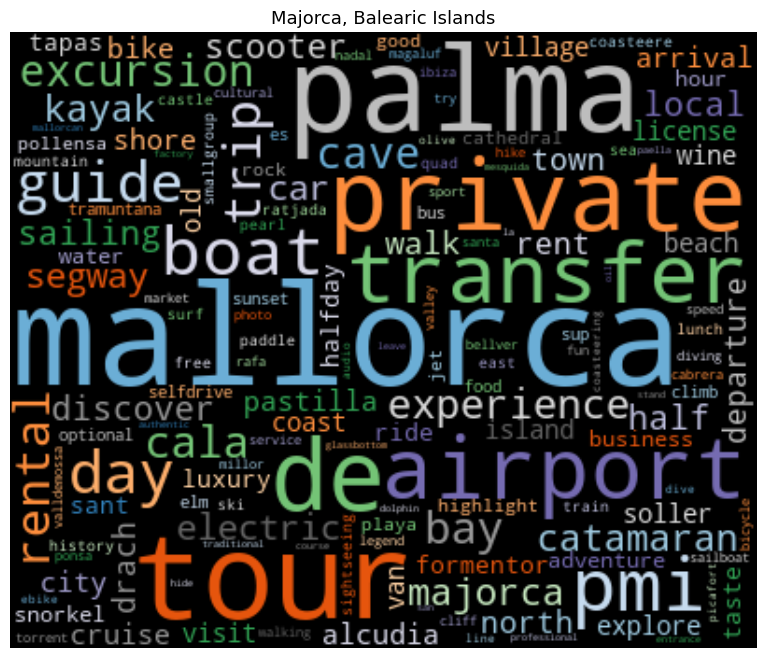

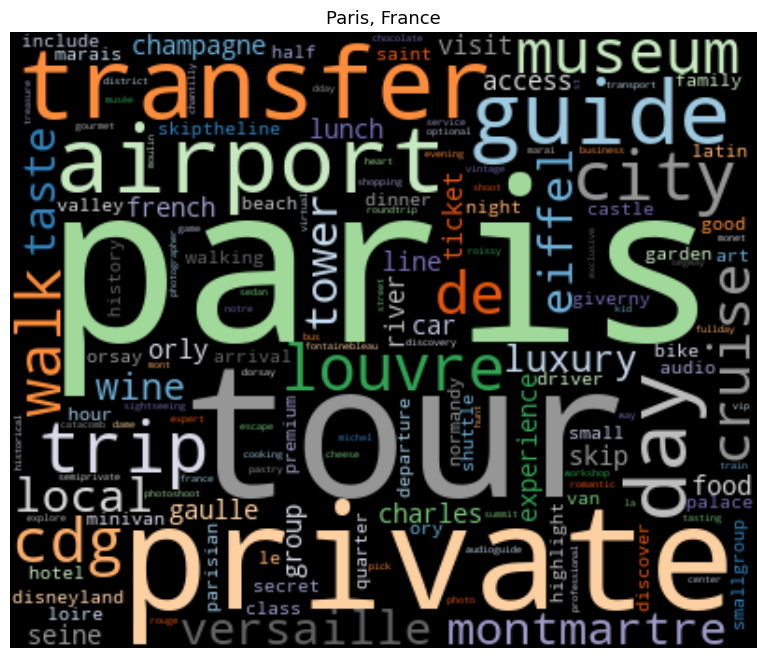

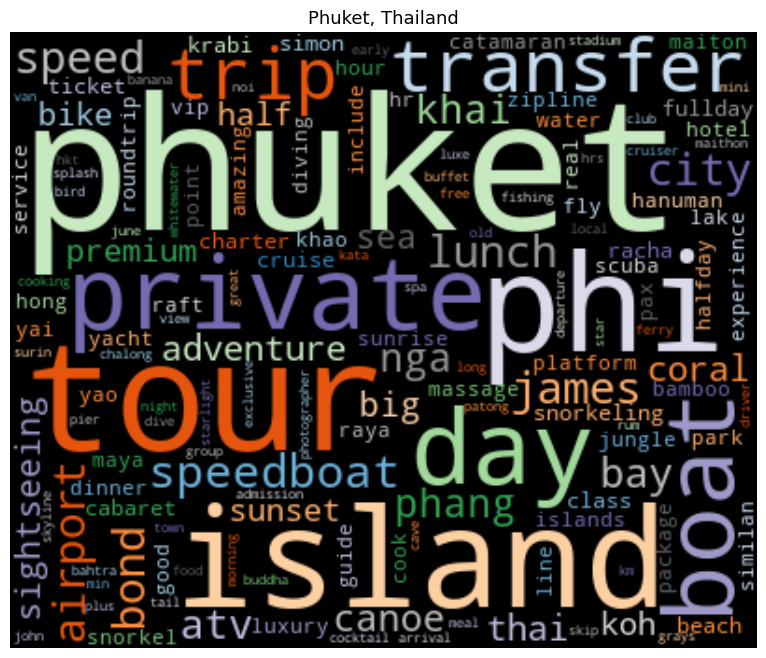

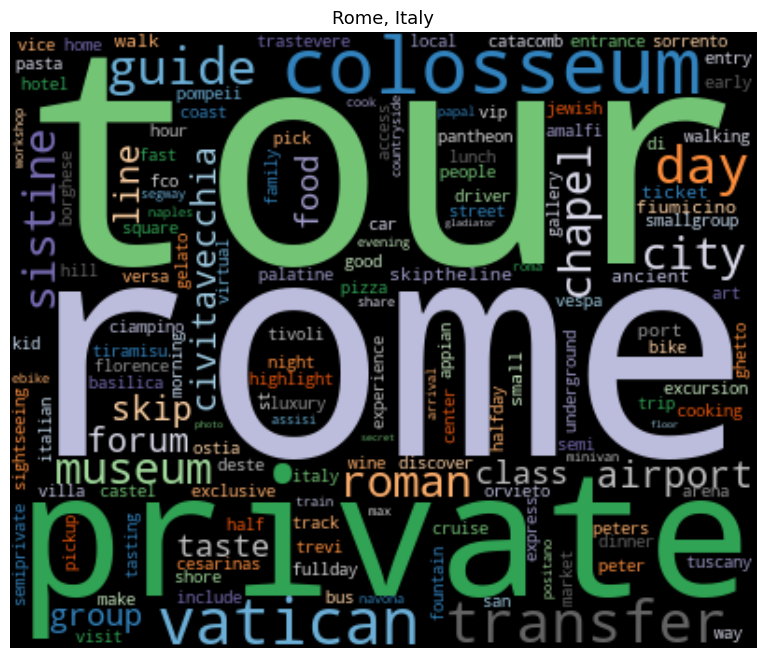

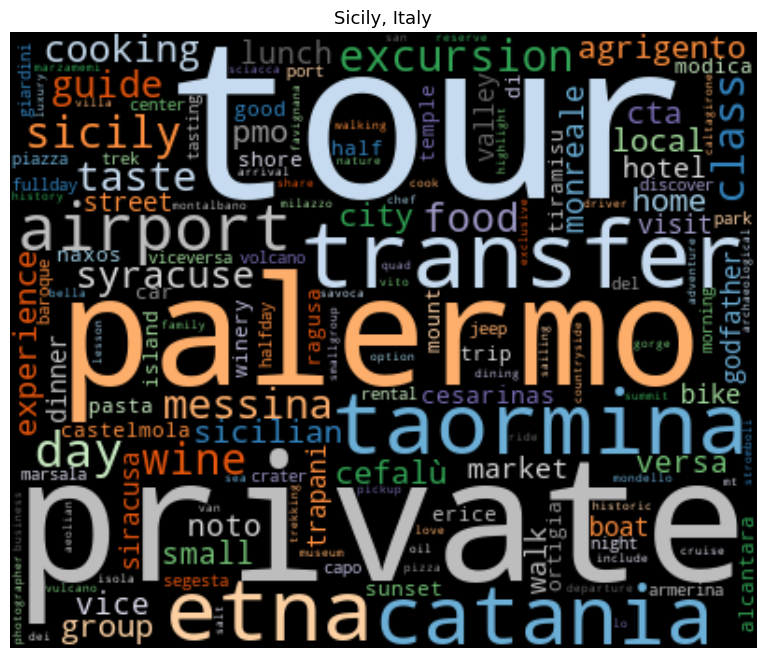

In [53]:
# Transposing document term matrix
df_dtm = df_dtm.transpose()

# Plotting word cloud for each city
for index, city in enumerate(df_dtm.columns):
    generate_wordcloud(df_dtm[city].sort_values(ascending=False), city)

In [54]:
# Look at top words with count vectorizer (in total, not per city)
sum_words = data.sum(axis=0)
words_freq = [(word, sum_words[0, idx]) for word, idx in cv.vocabulary_.items()]
words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)


### Word Clouds with TF-IDF Vectorization

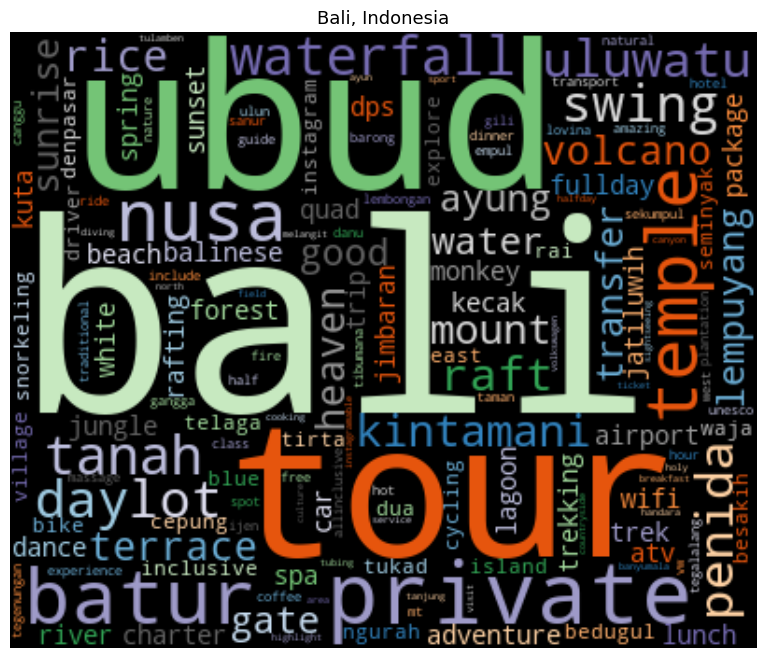

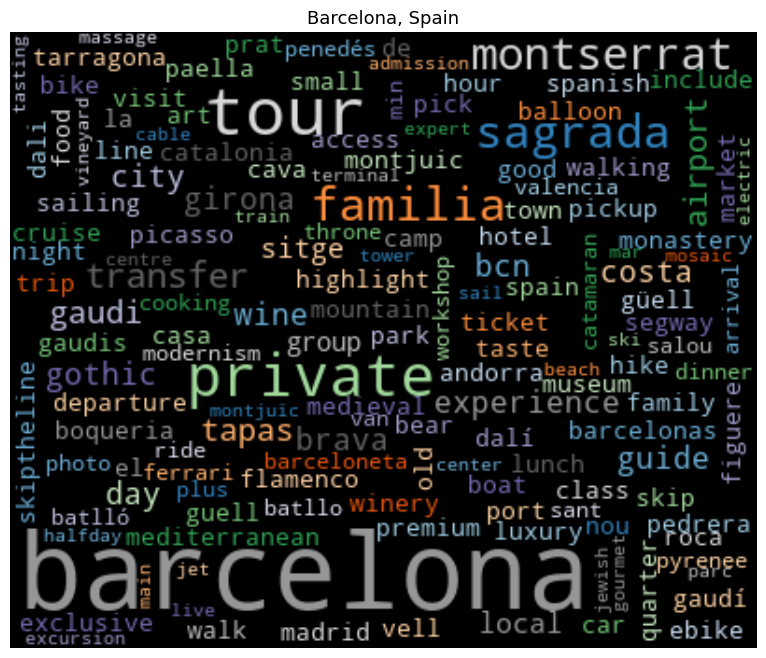

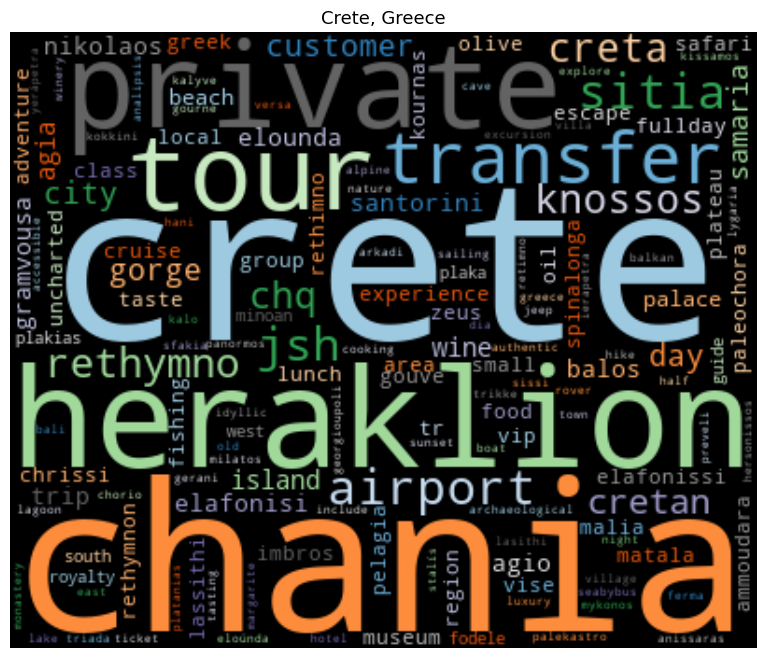

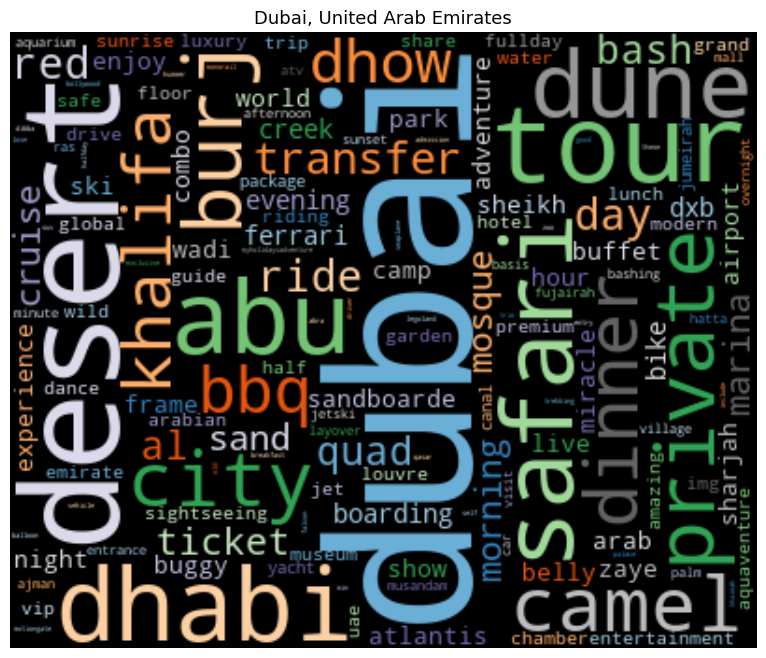

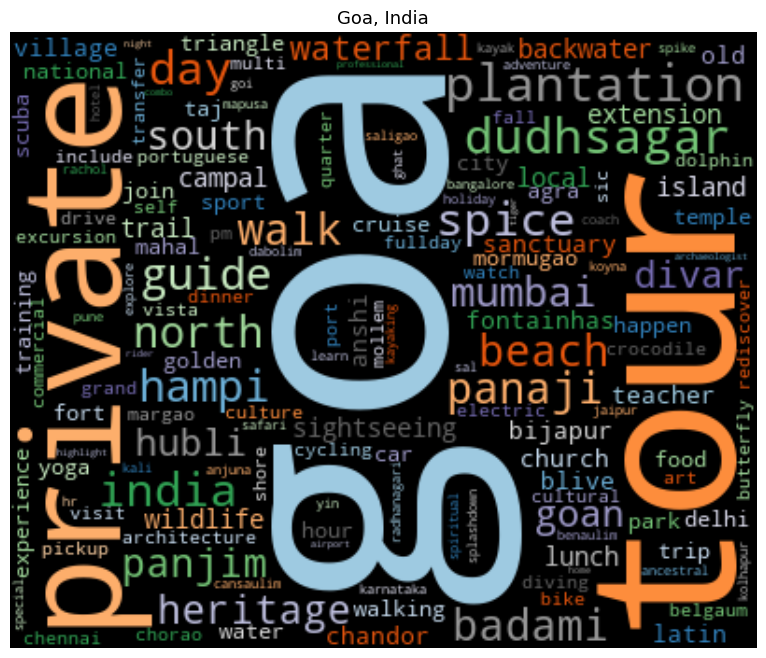

...

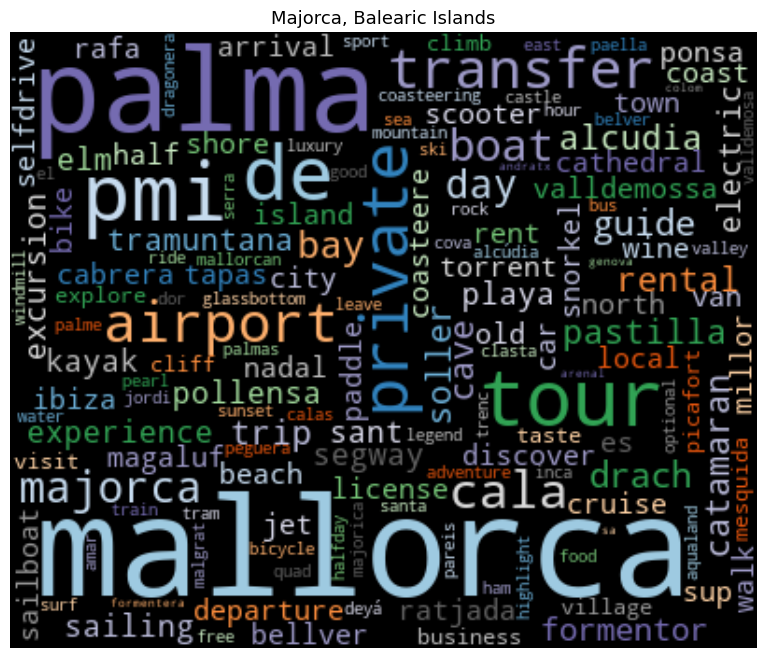

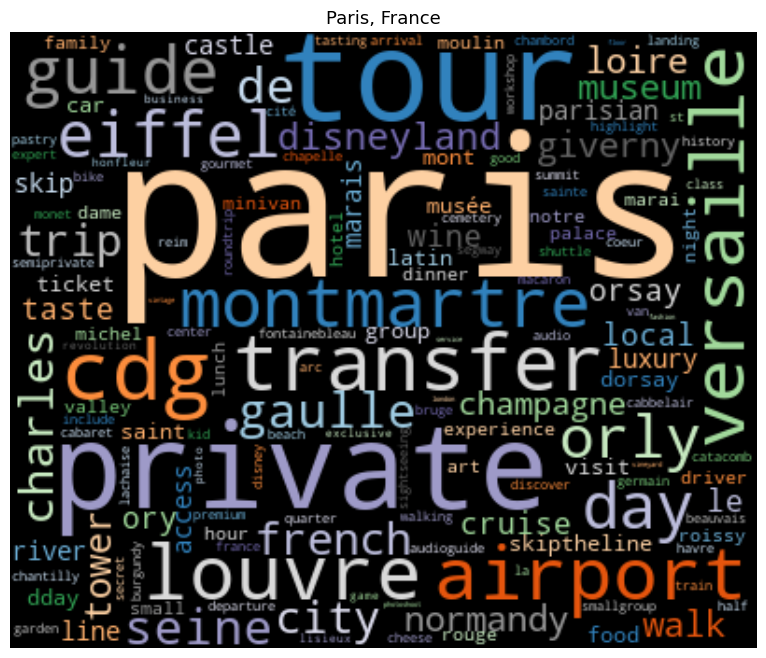

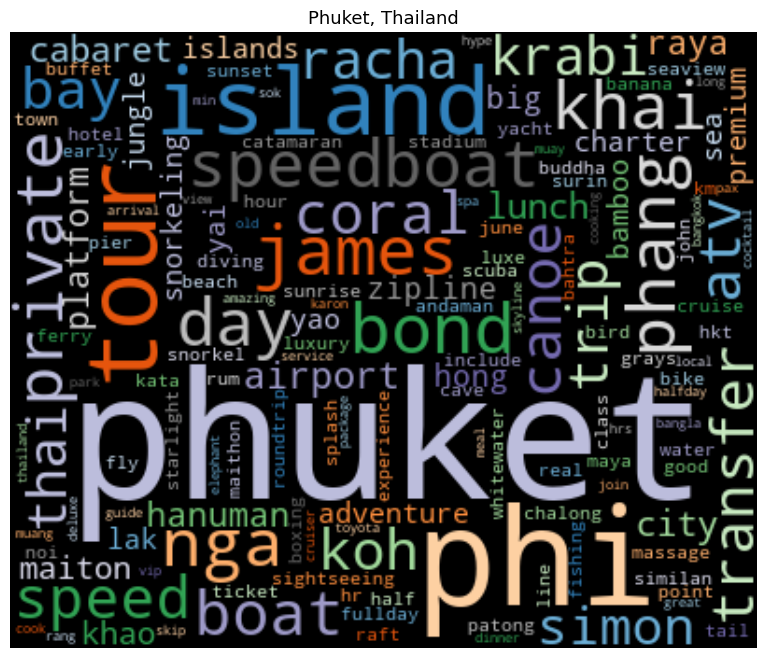

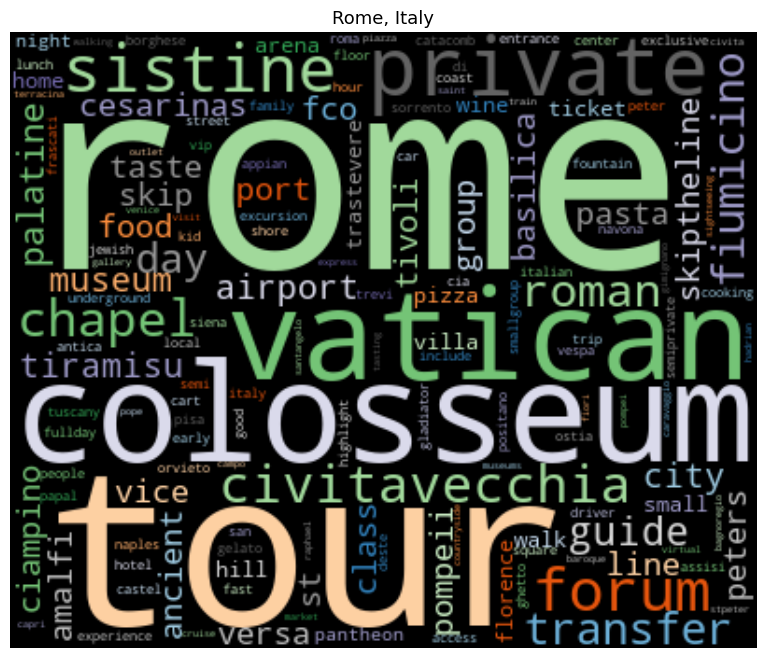

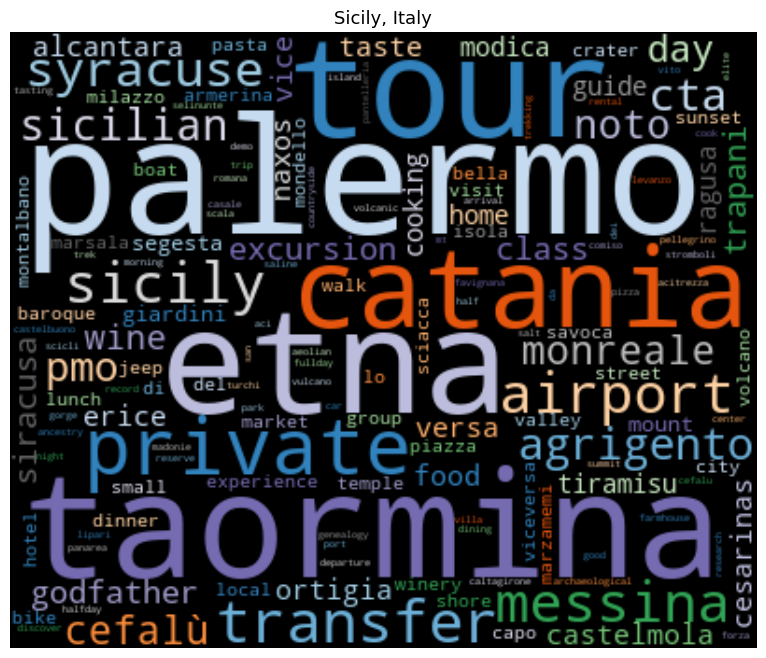

In [55]:
# Transposing document term matrix
df_dtm2 = df_dtm2.transpose()

# Plotting word cloud for each city
for index, city in enumerate(df_dtm2.columns):
    generate_wordcloud(df_dtm2[city].sort_values(ascending=False), city)

In [56]:
# Look at top words with tf-idf vectorization (for total words, not per city)
sum_words = data2.sum(axis=0)
words_freq = [(word, sum_words[0, idx]) for word, idx in tfidf.vocabulary_.items()]
words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)


**In contrast, there is not as much overlap with these words as in the count vectorization because tf-idf vectorization is finding more words that are unique to the cities. This tells us that tf-idf vectorization is probably a better vectorization technique to use while modeling in order to best predict the cities.**

### Word Clouds with Bi-Grams

In [57]:
cv2 = CountVectorizer(analyzer='word', stop_words=stopwords_list, ngram_range=(2,2))
data3 = cv2.fit_transform(df_grouped['lemmatized'])
df_dtm3 = pd.DataFrame(data3.toarray(), columns=cv2.get_feature_names_out())
df_dtm3.index = df_grouped.index


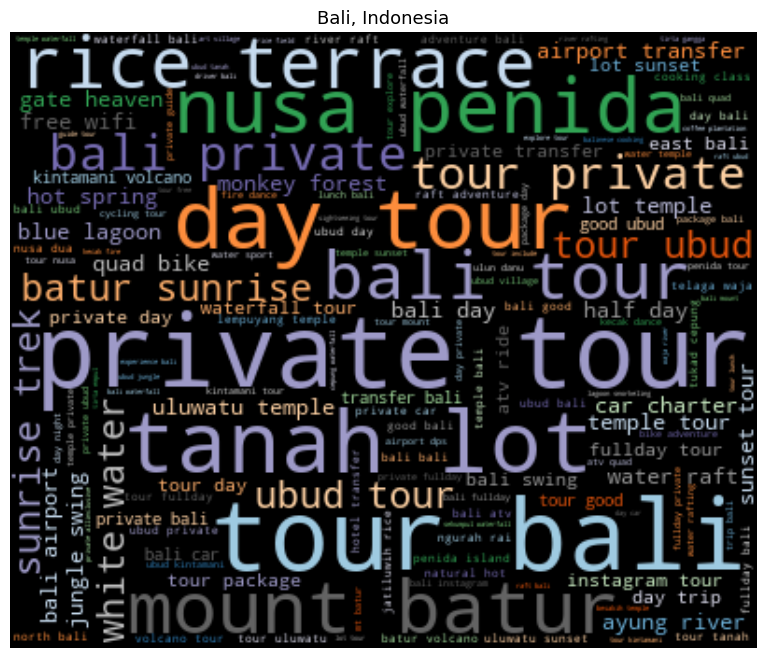

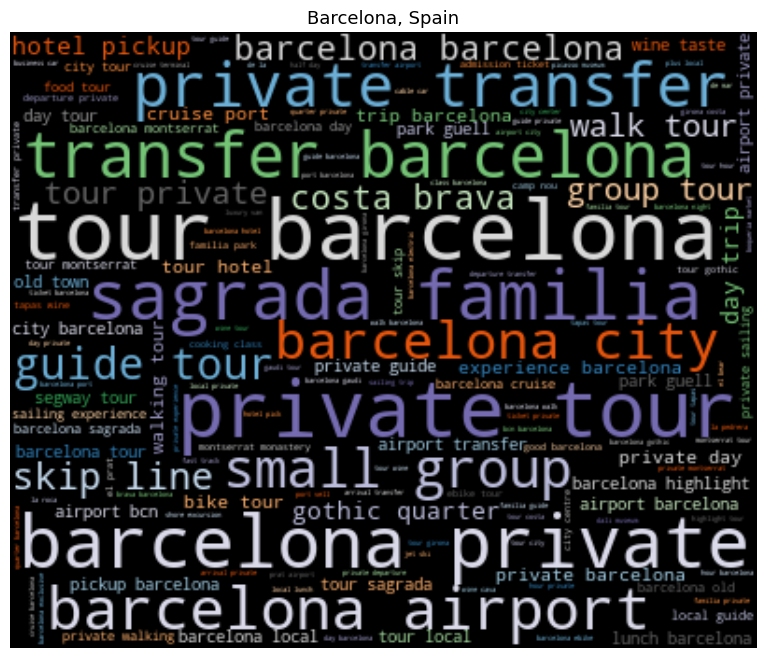

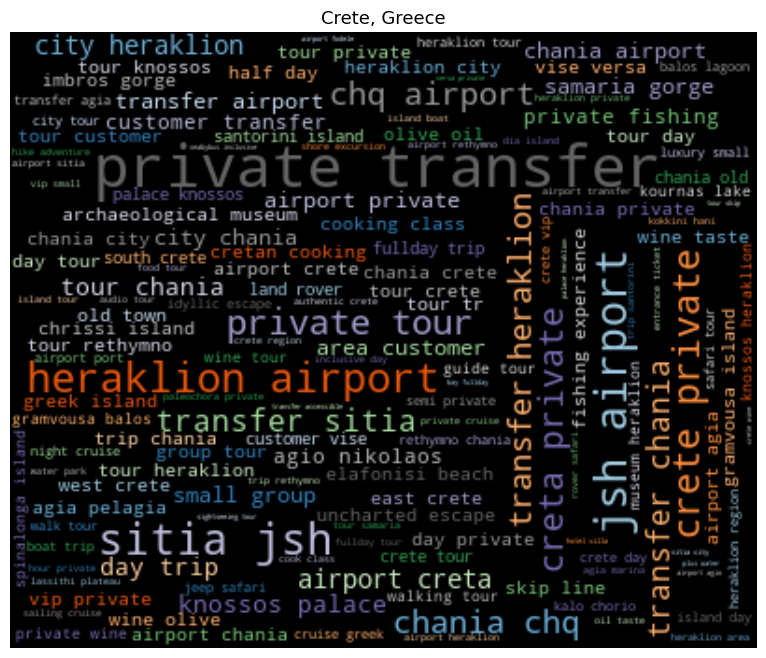

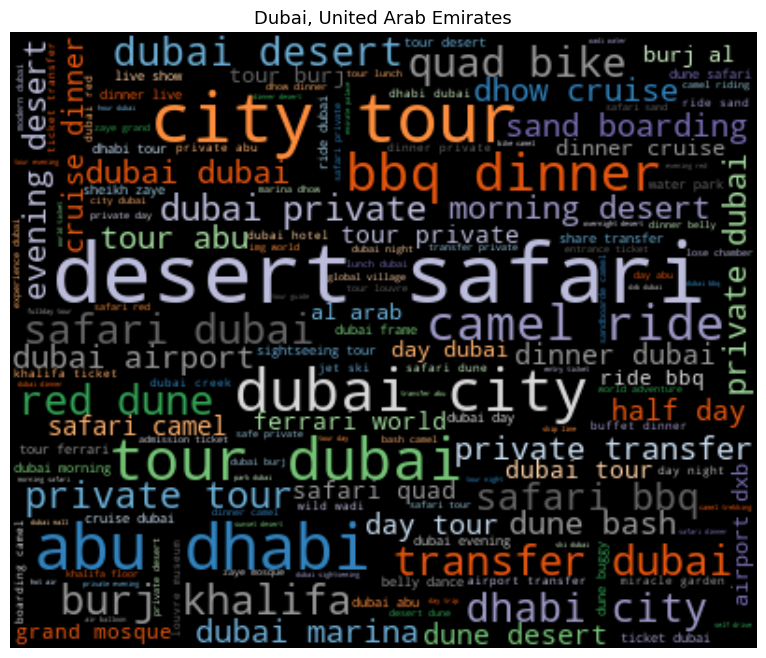

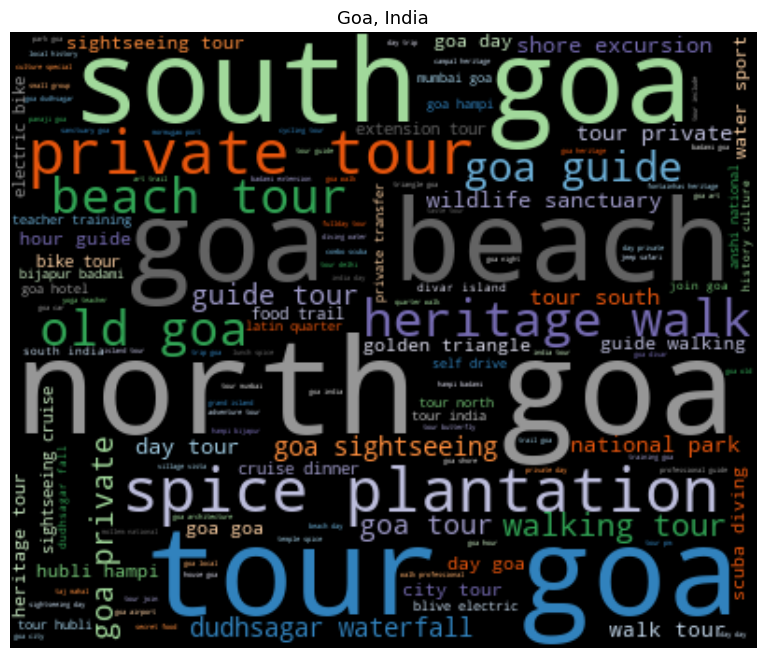

...

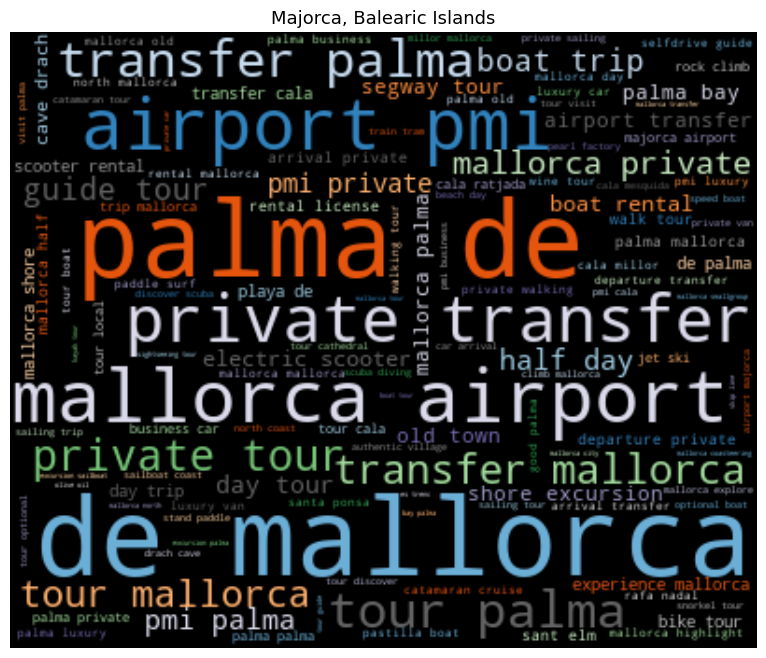

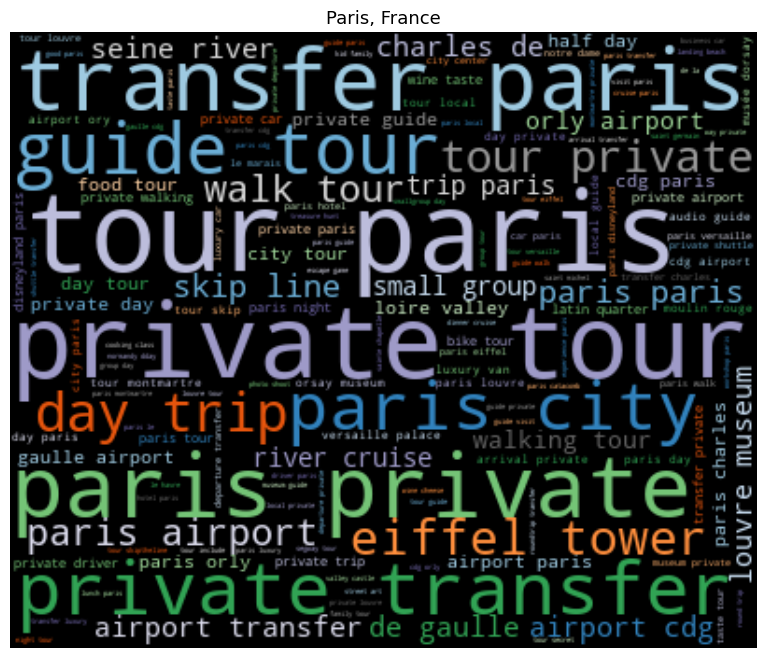

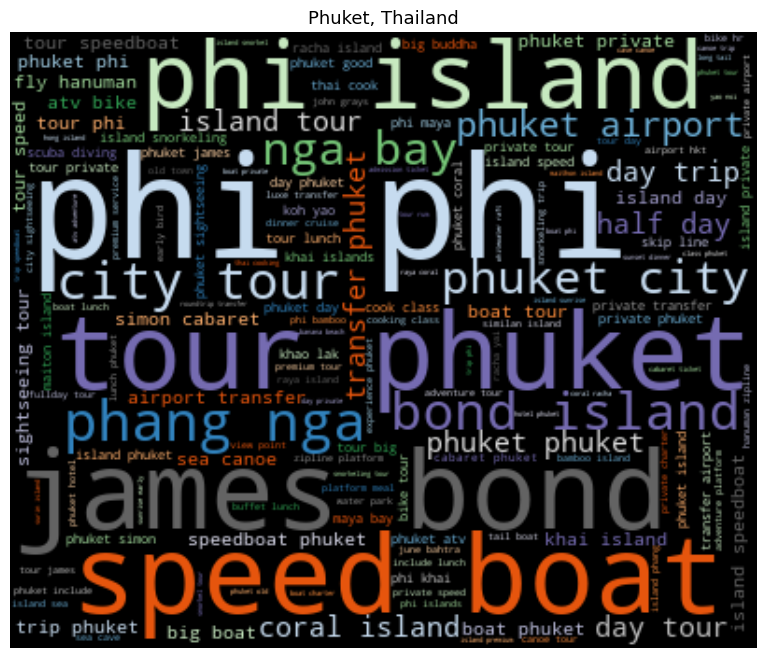

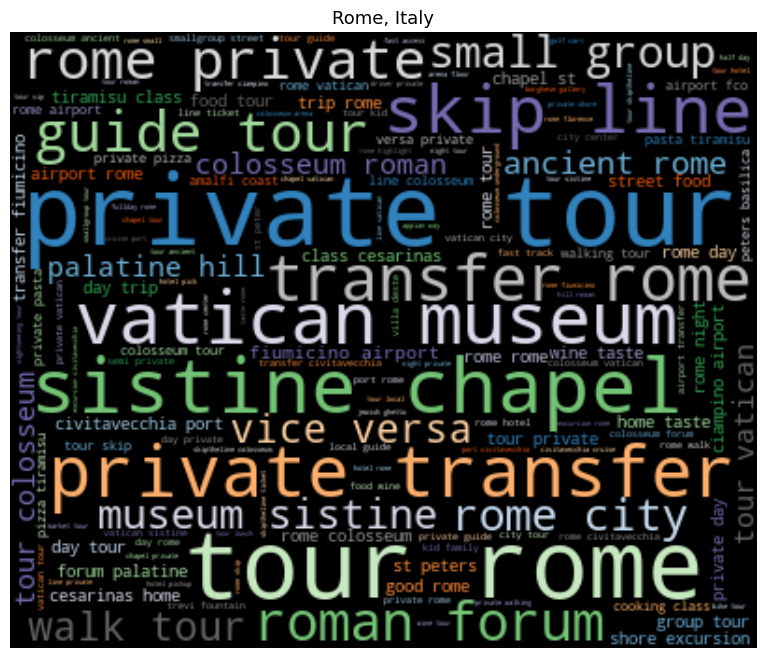

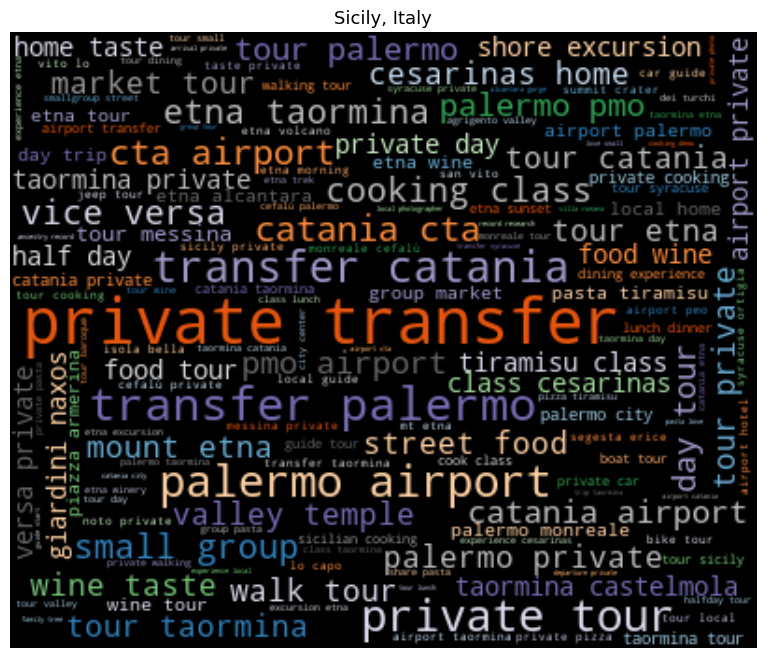

In [58]:
# Transposing document term matrix
df_dtm3 = df_dtm3.transpose()

# Plotting word cloud for each city
for index, city in enumerate(df_dtm3.columns):
    generate_wordcloud(df_dtm3[city].sort_values(ascending=False), city)

In [59]:
# Look at top bi-grams (in total, not per city)
sum_words = data3.sum(axis=0)
words_freq = [(word, sum_words[0, idx]) for word, idx in cv2.vocabulary_.items()]
words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)


**The bi-grams were able to pick out important terms, such as 'windsor castle' for London, and 'cooking class' for Sicily. However, words like 'tour' are creating some noise in most of these cities.**

### Removing Noise from the Data

Since there are still lots of words in the word clouds like 'private', 'airport' and 'transfer', we want to try to take those attractions for airport transfers out because they are causing noise in the data.

In [60]:
df.head()

,Attraction,City,cleaned,lemmatized
0,SEA LIFE London Aquarium Admission Ticket,"London, United Kingdom",sea life london aquarium admission ticket,sea life london aquarium admission ticket
1,The Jack The Ripper Walking Tour in London,"London, United Kingdom",the jack the ripper walking tour in london,jack ripper walking tour london
2,Ghost Bus Tour of London,"London, United Kingdom",ghost bus tour of london,ghost bus tour london
3,Big Bus London Hop-On Hop-Off Tour and River C...,"London, United Kingdom",big bus london hopon hopoff tour and river cru...,big bus london hopon hopoff tour river cruise ...
4,The Blood and Tears Walk: Serial Killers and L...,"London, United Kingdom",the blood and tears walk serial killers and lo...,blood tear walk serial killer london horror


In [61]:
# Preview what I want to drop
df.loc[df['Attraction'].str.contains('airport')]

,Attraction,City,cleaned,lemmatized
329,Private transfer from Heathrow airport to Sout...,"London, United Kingdom",private transfer from heathrow airport to sout...,private transfer heathrow airport southampton ...
639,Private transfer from city airport to central ...,"London, United Kingdom",private transfer from city airport to central ...,private transfer city airport central london
640,private transfer from central london to city a...,"London, United Kingdom",private transfer from central london to city a...,private transfer central london city airport
1549,Private airport transfers in London,"London, United Kingdom",private airport transfers in london,private airport transfer london
1830,London airport transfer from Heathrow Airport ...,"London, United Kingdom",london airport transfer from heathrow airport ...,london airport transfer heathrow airport lhr l...
...,...,...,...,...
1407,"Private 4-hour tour of Dubai from hotel, airpo...","Dubai, United Arab Emirates",private tour of dubai from hotel airport or c...,private tour dubai hotel airport cruise loca...
2398,"Dubai airport terminal 1,2 or 3 to Ras Al Khaimah","Dubai, United Arab Emirates",dubai airport terminal or to ras al khaimah,dubai airport terminal ras al khaimah
2407,"Dubai airport terminal 1,2 or 3 to Ajman","Dubai, United Arab Emirates",dubai airport terminal or to ajman,dubai airport terminal ajman
2408,"Dubai airport terminal 1,2 or 3 to Sharjah city","Dubai, United Arab Emirates",dubai airport terminal or to sharjah city,dubai airport terminal sharjah city


In [62]:
# Get rid of the airport transfer 'attractions'
df2 = df.drop(df.loc[df['Attraction'].str.contains('airport')].index)

In [63]:
df2 = df.drop(df2.loc[df2['Attraction'].str.contains('transfer')].index)

In [64]:
# Just in case, add these words to the stopwords list
stopwords_list += ['airport', 'transfer', 'private']

In [65]:
print(df.shape)
print(df2.shape)

(27533, 4)
(25315, 4)


**Create some functions to make the preprocessing steps easier**


In [66]:
def preprocess_df(df, column, preview=True, lemmatize=True):
    """
    Input df with raw text attractions.
    Return df with preprocessed text.
    If preview=True, returns a preview of the new df.
    """
    
    df[column] = df['Attraction'].apply(lambda x: x.lower())
    df[column] = df[column].apply(lambda x: re.sub('[%s]' % re.escape(string.punctuation), '', x))
    df[column] = df[column].apply(lambda x: re.sub('\w*\d\w*','', x))
    
    if lemmatize:
        df[column] = df[column].apply(lambda x: ' '.join(
                                        [token.lemma_ for token in list(nlp(x)) if (token.is_stop==False)]))
    if preview:
        display(df.head(10))
        
    return df

In [67]:
def group_text_per_city(df, column):
    """
    Groups the preprocessed text per city.
    """
    df_to_group = df[['City', column]]
    df_grouped = df_to_group.groupby(by='City').agg(lambda x:' '.join(x))
    return df_grouped

In [68]:
def create_doc_term_matrix(df, column, count_vec=True, ngram_range=(1,1)):
    """
    Creates a document term matrix.
    Defaults to count vectorizer with optional n-gram param.
    If count_vec==False, uses a TF-IDF vectorizer.
    """
    df_grouped = group_text_per_city(df, column)
    
    if count_vec:
        vec = CountVectorizer(analyzer='word', stop_words=stopwords_list, ngram_range=ngram_range)
    else:
        vec = TfidfVectorizer(analyzer='word', stop_words=stopwords_list)
    
    data = vec.fit_transform(df_grouped[column])
    df_dtm = pd.DataFrame(data.toarray(), columns=vec.get_feature_names_out())
    df_dtm.index = df_grouped.index
    return df_dtm.transpose()

In [73]:
preprocessed_df = preprocess_df(df2, 'lemmatized')
dtm_cv = create_doc_term_matrix(preprocessed_df, 'lemmatized', count_vec=True)

,Attraction,City,cleaned,lemmatized
0,SEA LIFE London Aquarium Admission Ticket,"London, United Kingdom",sea life london aquarium admission ticket,sea life london aquarium admission ticket
1,The Jack The Ripper Walking Tour in London,"London, United Kingdom",the jack the ripper walking tour in london,jack ripper walking tour london
2,Ghost Bus Tour of London,"London, United Kingdom",ghost bus tour of london,ghost bus tour london
3,Big Bus London Hop-On Hop-Off Tour and River C...,"London, United Kingdom",big bus london hopon hopoff tour and river cru...,big bus london hopon hopoff tour river cruise ...
5,London Ghost and Infamous Murders Walking Tour,"London, United Kingdom",london ghost and infamous murders walking tour,london ghost infamous murder walk tour
6,"Stonehenge, Windsor Castle, and Bath from London","London, United Kingdom",stonehenge windsor castle and bath from london,stonehenge windsor castle bath london
7,Warner Bros. Studio: The Making of Harry Potte...,"London, United Kingdom",warner bros studio the making of harry potter ...,warner bros studio making harry potter luxury ...
8,"Ghosts, Ghouls & Gallows: London Virtual Tour","London, United Kingdom",ghosts ghouls gallows london virtual tour,ghosts ghoul gallow london virtual tour
9,High-Speed Thames River RIB Cruise in London,"London, United Kingdom",highspeed thames river rib cruise in london,highspeed thames river rib cruise london
10,Alcotraz: Prison Cocktail Experience (Shoreditch),"London, United Kingdom",alcotraz prison cocktail experience shoreditch,alcotraz prison cocktail experience shoreditch


In [74]:
dtm_bigram = create_doc_term_matrix(df2, 'lemmatized',count_vec=True, ngram_range=(2,2))

In [78]:
dtm_tfidf = create_doc_term_matrix(df2, 'lemmatized', count_vec=False)


### Making Nicer Word Clouds

In [75]:
def generate_better_wordcloud(data, title, mask=None):
    cloud = WordCloud(scale=3, max_words=150, colormap='tab20c', mask=mask,
                      background_color='white').generate_from_frequencies(data)
    plt.figure(figsize=(10,8))
    plt.imshow(cloud, interpolation='bilinear')
    plt.axis('off')
    plt.title('\n'.join(wrap(title,60)), fontsize=13)
    plt.show()

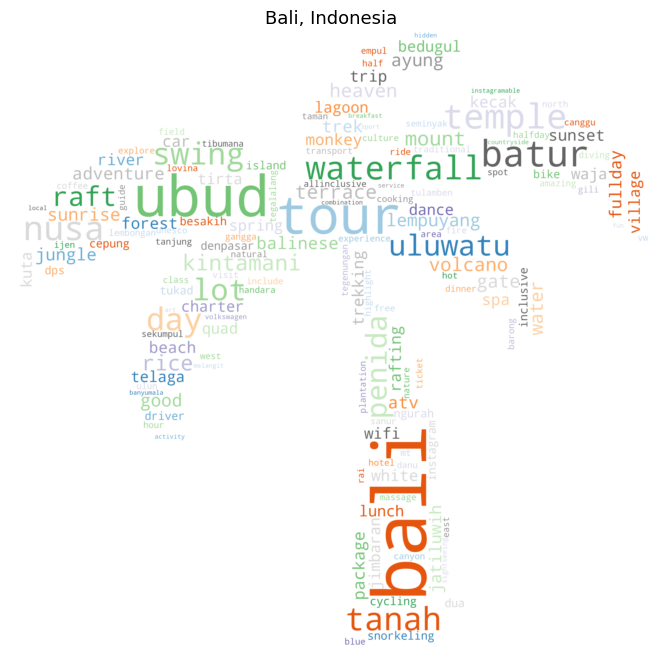

In [79]:
mask = np.array(Image.open('../Images/palm2.jpg'))
generate_better_wordcloud(dtm_tfidf['Bali, Indonesia'].sort_values(ascending=False),'Bali, Indonesia', mask=mask)

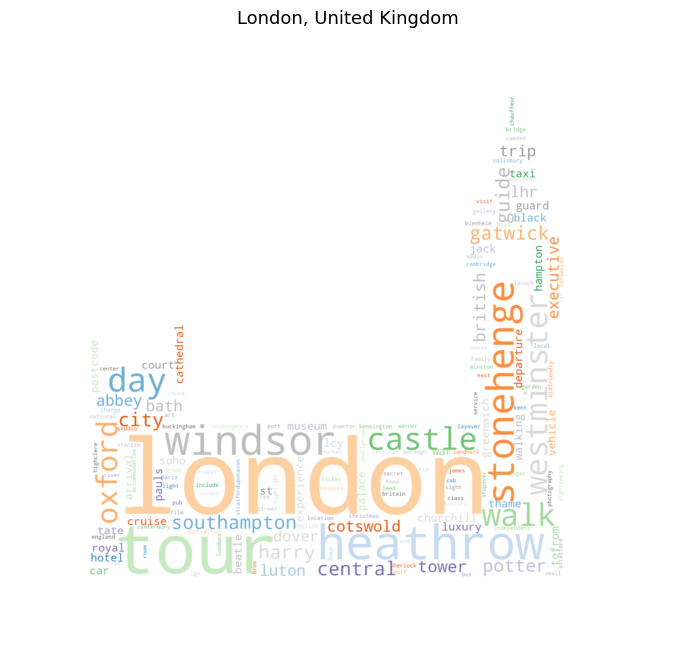

In [80]:
mask_london = np.array(Image.open('../Images/ben.jpg'))
generate_better_wordcloud(dtm_tfidf['London, United Kingdom'].sort_values(ascending=False),
                          'London, United Kingdom', mask=mask_london)

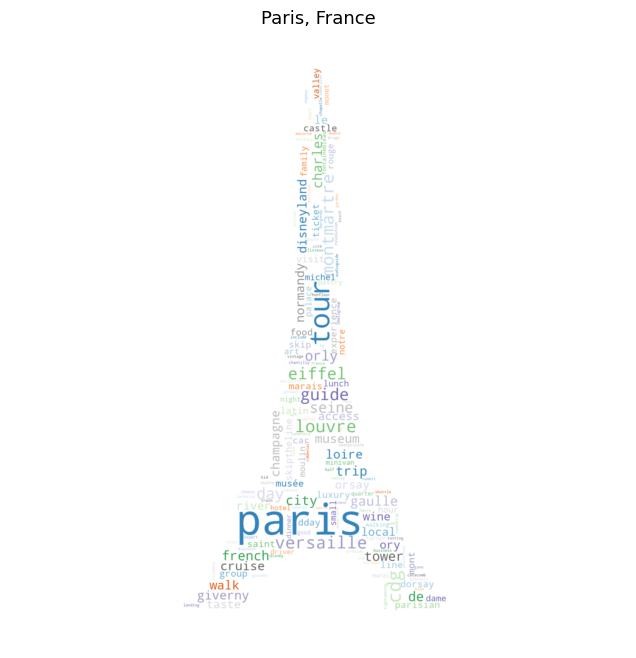

In [81]:
mask_paris = np.array(Image.open('../Images/paris.jpg'))
generate_better_wordcloud(dtm_tfidf['Paris, France'].sort_values(ascending=False),
                          'Paris, France', mask=mask_paris)

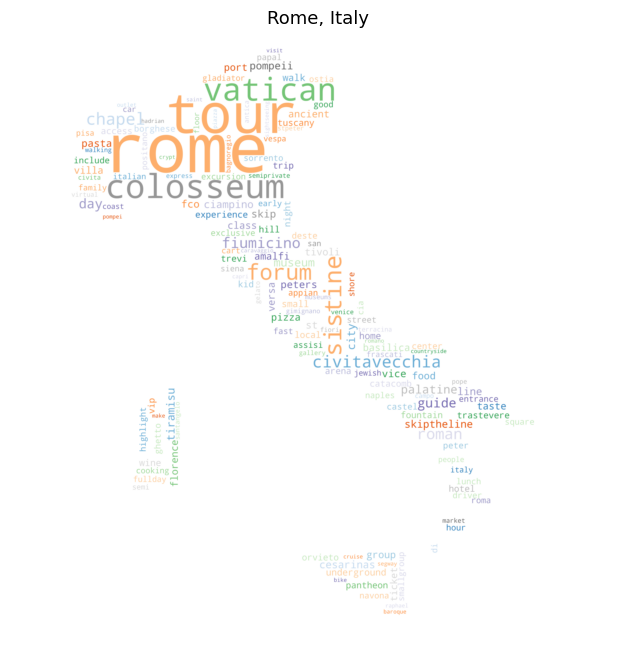

In [82]:
mask_rome = np.array(Image.open('../Images/italy.jpg'))
generate_better_wordcloud(dtm_tfidf['Rome, Italy'].sort_values(ascending=False),
                          'Rome, Italy', mask=mask_rome)

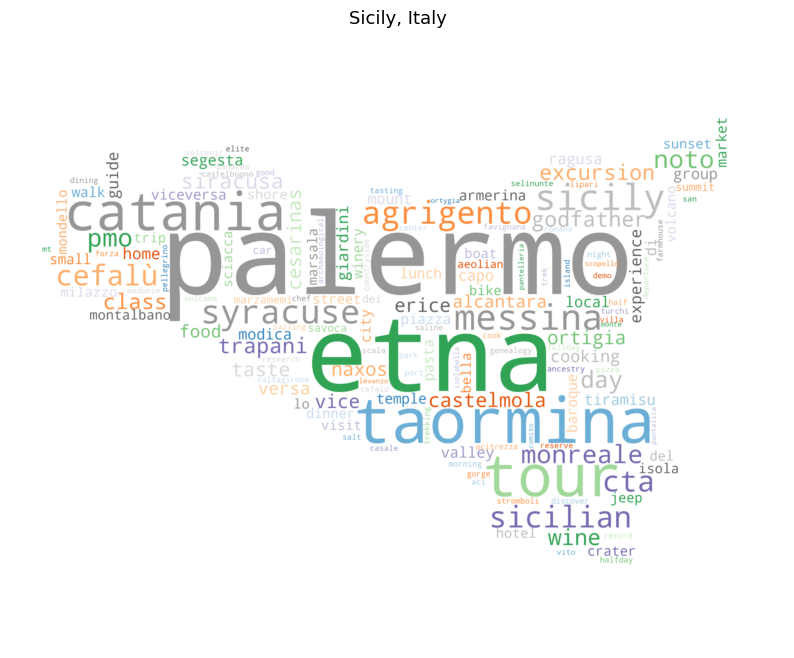

In [83]:
mask_sicily = np.array(Image.open('../Images/sicily.jpg'))
generate_better_wordcloud(dtm_tfidf['Sicily, Italy'].sort_values(ascending=False),
                          'Sicily, Italy', mask=mask_sicily)

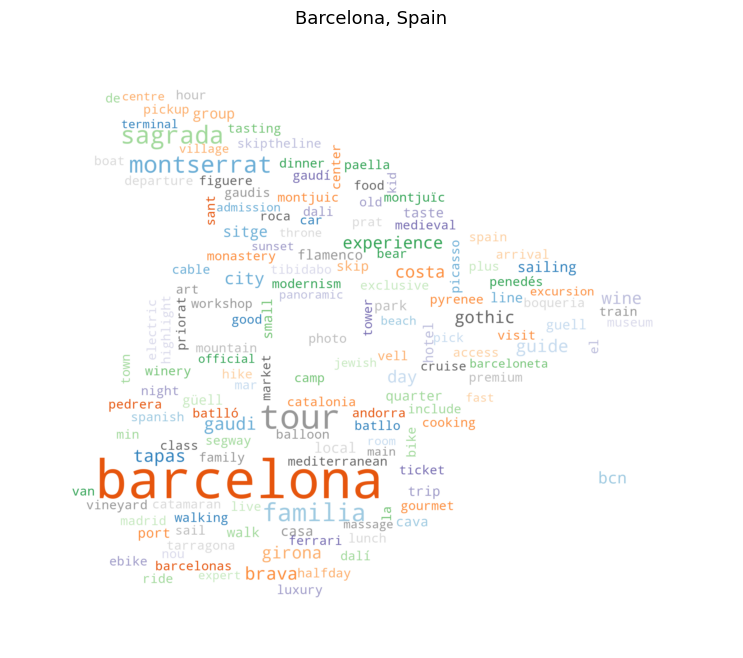

In [84]:
mask_barca = np.array(Image.open('../Images/spain_flag.jpg'))
generate_better_wordcloud(dtm_tfidf['Barcelona, Spain'].sort_values(ascending=False),
                          'Barcelona, Spain', mask=mask_barca)

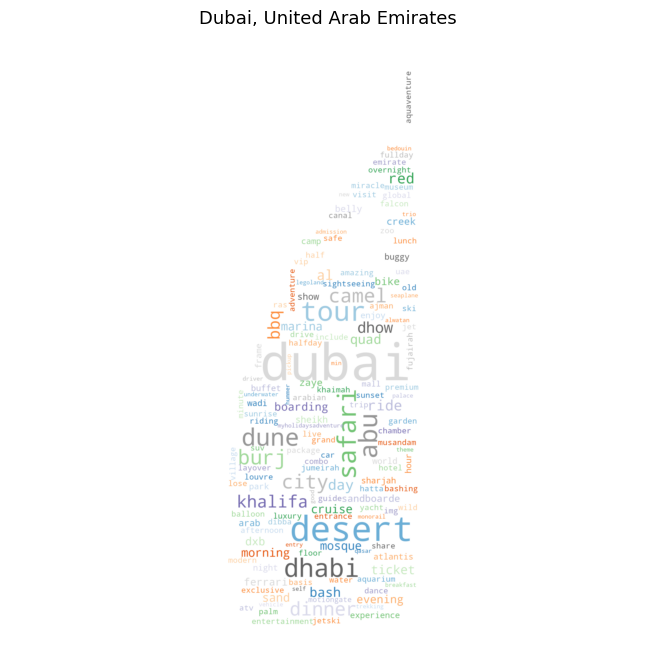

In [86]:
mask_dubai = np.array(Image.open('../Images/dubai.jpg'))
generate_better_wordcloud(dtm_tfidf['Dubai, United Arab Emirates'].sort_values(ascending=False),
                          'Dubai, United Arab Emirates', mask=mask_dubai)

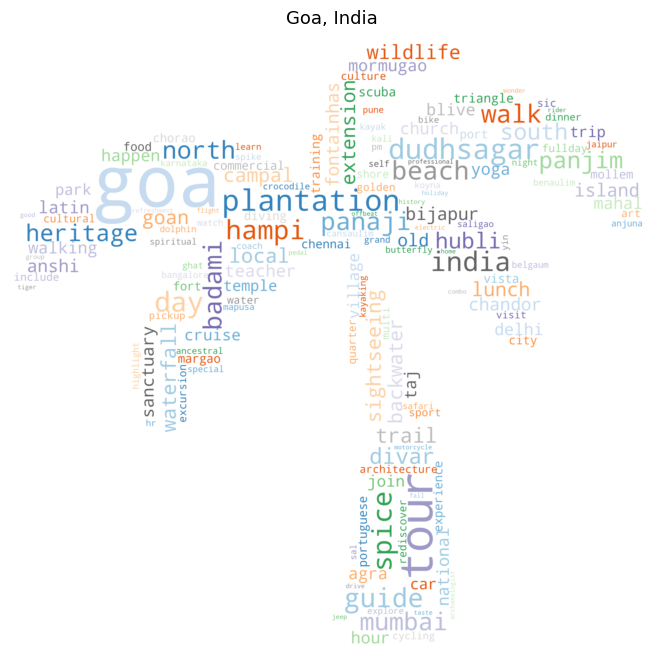

In [87]:
generate_better_wordcloud(dtm_tfidf['Goa, India'].sort_values(ascending=False),
                          'Goa, India', mask=mask)

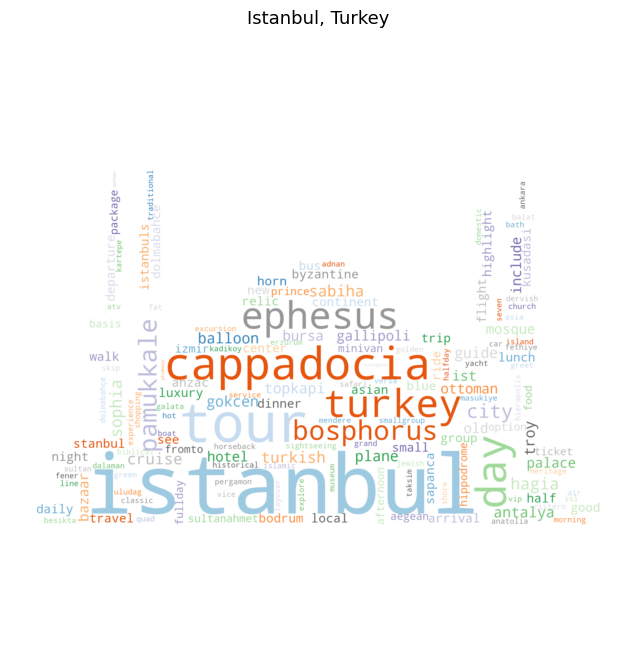

In [88]:
mask_istanbul = np.array(Image.open('../Images/hagia_sophia.jpg'))
generate_better_wordcloud(dtm_tfidf['Istanbul, Turkey'].sort_values(ascending=False),
                          'Istanbul, Turkey', mask=mask_istanbul)

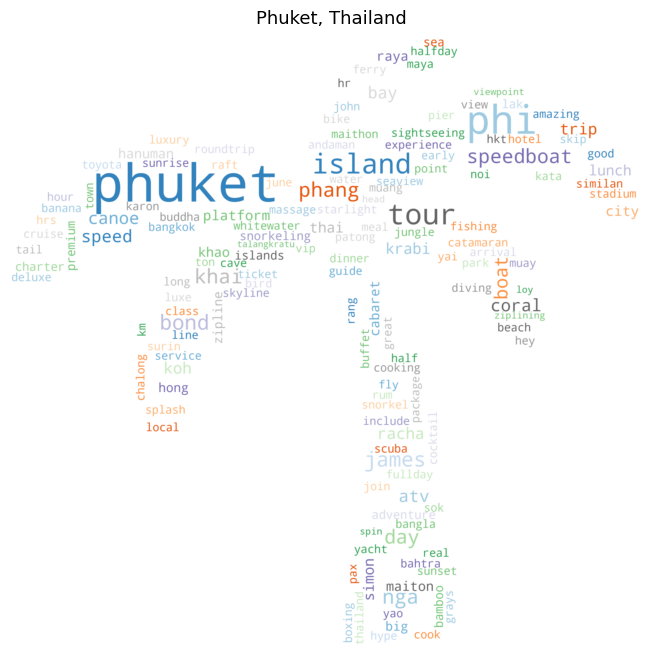

In [89]:
generate_better_wordcloud(dtm_tfidf['Phuket, Thailand'].sort_values(ascending=False),
                          'Phuket, Thailand', mask=mask)

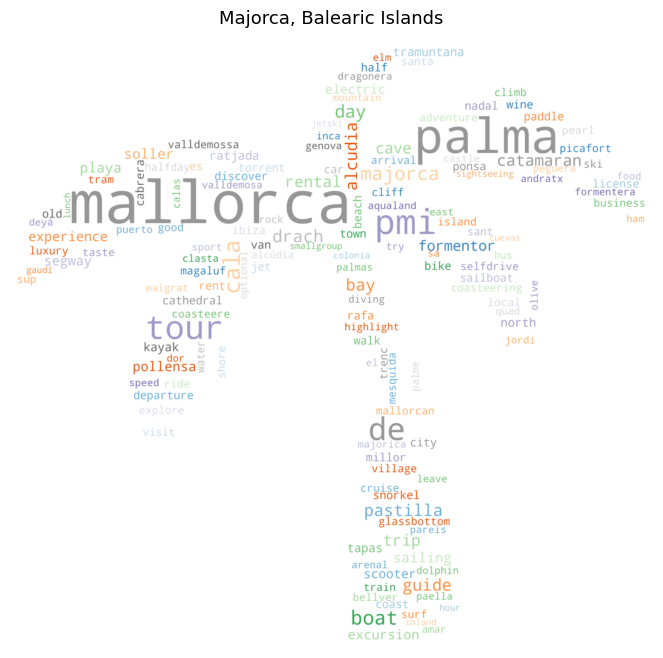

In [90]:
generate_better_wordcloud(dtm_tfidf['Majorca, Balearic Islands'].sort_values(ascending=False),
                          'Majorca, Balearic Islands', mask=mask)

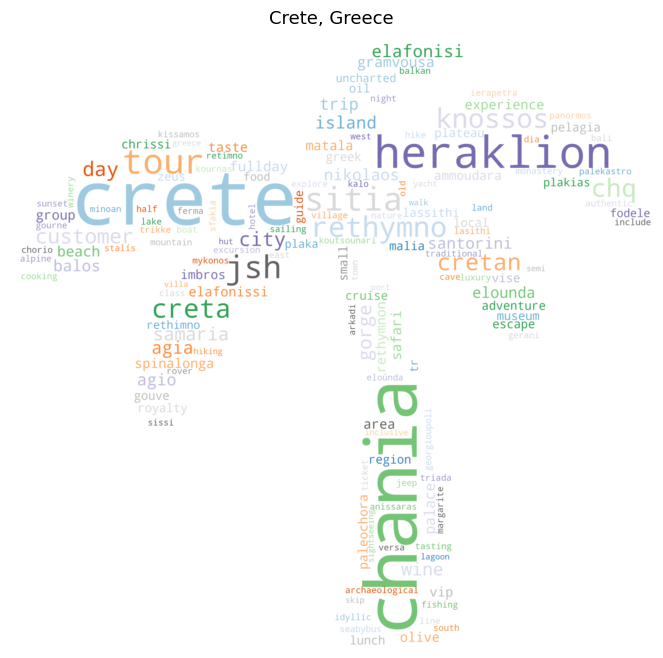

In [91]:
generate_better_wordcloud(dtm_tfidf['Crete, Greece'].sort_values(ascending=False),
                          'Crete, Greece', mask=mask)

 Most Frequent Words Visualizations
- Find the most frequent words per city and visualize them

In [92]:
# Group the corpora by city and join them
df_to_group = preprocessed_df[['City', 'lemmatized']]
df_grouped = df_to_group.groupby(by='City').agg(lambda x:' '.join(x))
df_grouped

,lemmatized
City,
"Bali, Indonesia",hotel hotelbali private transfer daytime bali ...
"Barcelona, Spain",interactive spanish cooking experience barcelo...
"Crete, Greece",minoans world museum cinema crete wine ol...
"Dubai, United Arab Emirates",premium red dune camel safari bbq al khayma ...
"Goa, India",fontainhas heritage walk sunset cruise paradis...
"Istanbul, Turkey",bosphorus sunset cruise luxury yacht istanbu...
"London, United Kingdom",sea life london aquarium admission ticket jack...
"Majorca, Balearic Islands",cave genova admission palma de mallorca shore ...
"Paris, France",bateaux parisien seine river gourmet dinner ...


In [93]:
city_freqs = {}
for city in df_grouped.index:
    city_text = df_grouped.loc[city, 'lemmatized']
    fd = FreqDist(word_tokenize(city_text))
    city_freqs[city] = fd.most_common(20)
city_freqs_df = pd.DataFrame(city_freqs)
city_freqs_df.head()

,"Bali, Indonesia","Barcelona, Spain","Crete, Greece","Dubai, United Arab Emirates","Goa, India","Istanbul, Turkey","London, United Kingdom","Majorca, Balearic Islands","Paris, France","Phuket, Thailand","Rome, Italy","Sicily, Italy"
0,"(bali, 2206)","(barcelona, 1105)","(private, 340)","(dubai, 2144)","(goa, 221)","(istanbul, 1340)","(london, 1860)","(mallorca, 209)","(paris, 1653)","(phuket, 586)","(tour, 2616)","(tour, 759)"
1,"(tour, 2190)","(tour, 861)","(tour, 272)","(tour, 1321)","(tour, 150)","(tour, 1243)","(tour, 1463)","(tour, 144)","(tour, 1152)","(tour, 398)","(rome, 2611)","(private, 554)"
2,"(private, 1025)","(private, 616)","(transfer, 259)","(desert, 900)","(private, 45)","(day, 668)","(private, 1201)","(palma, 134)","(private, 949)","(island, 316)","(private, 1630)","(palermo, 422)"
3,"(ubud, 869)","(transfer, 172)","(airport, 251)","(safari, 898)","(day, 39)","(private, 578)","(airport, 439)","(private, 97)","(transfer, 297)","(phi, 310)","(colosseum, 656)","(transfer, 317)"
4,"(day, 669)","(airport, 152)","(crete, 216)","(private, 708)","(guide, 34)","(airport, 301)","(transfer, 427)","(de, 90)","(airport, 295)","(day, 161)","(vatican, 649)","(etna, 312)"


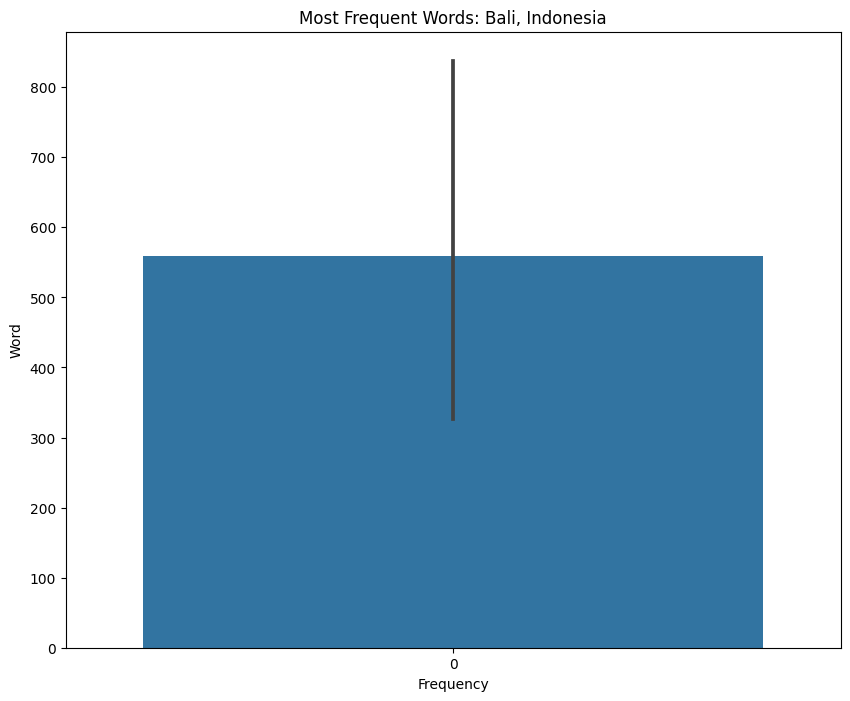

In [94]:
# Make one graph of most frequent words
yaxis = [x[0] for x in city_freqs_df['Bali, Indonesia']]
xaxis = [x[1] for x in city_freqs_df['Bali, Indonesia']]

plt.figure(figsize=(10,8))
sns.barplot(xaxis)
plt.title('Most Frequent Words: Bali, Indonesia')
plt.xlabel('Frequency')
plt.ylabel('Word')
plt.show()

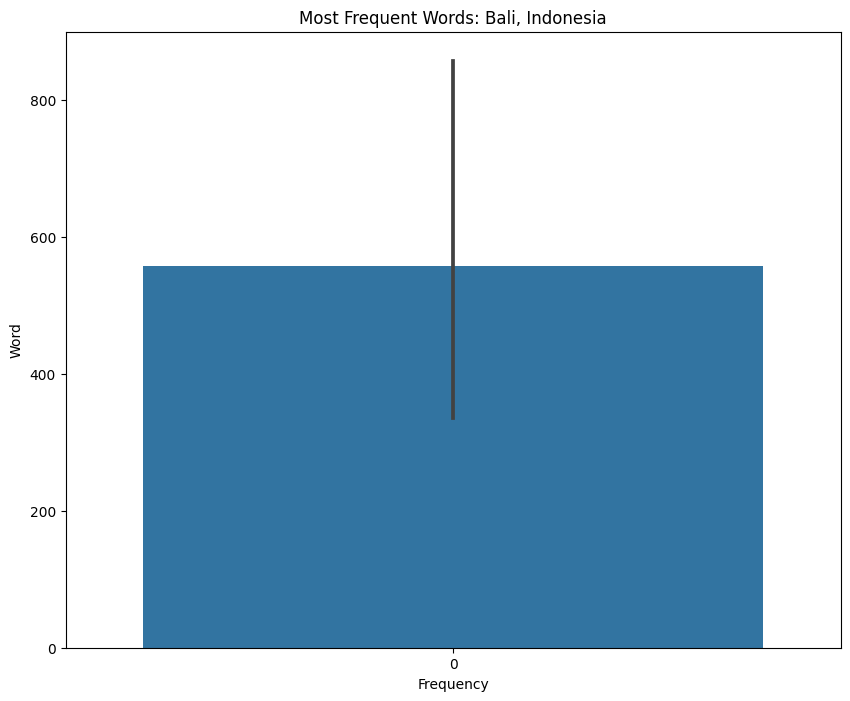

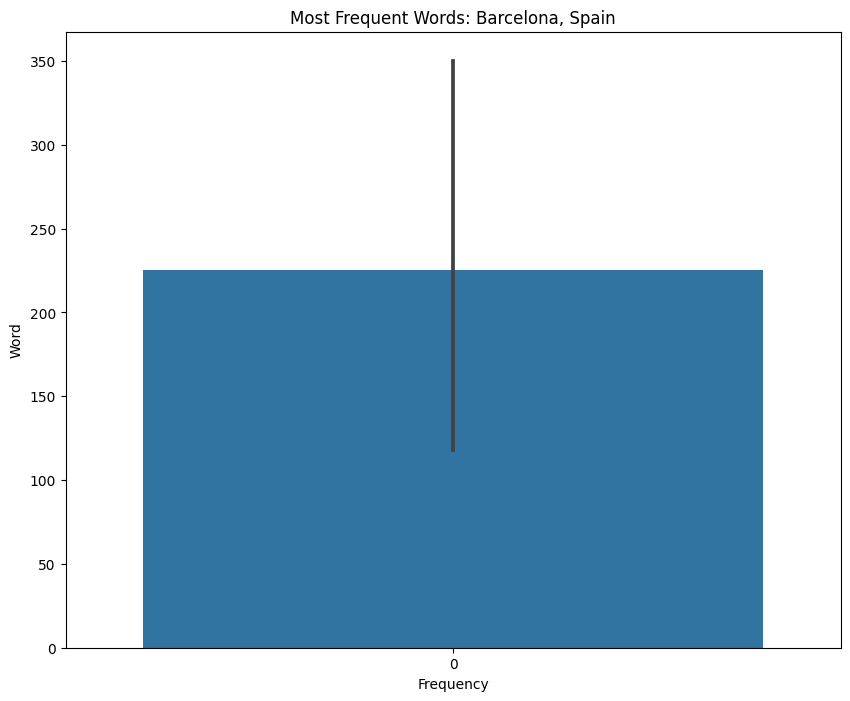

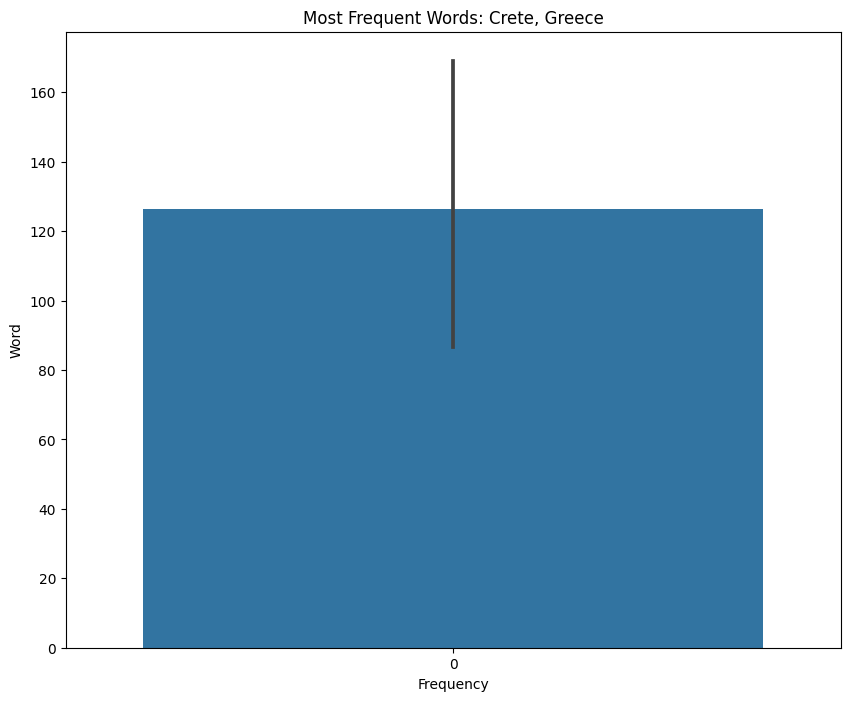

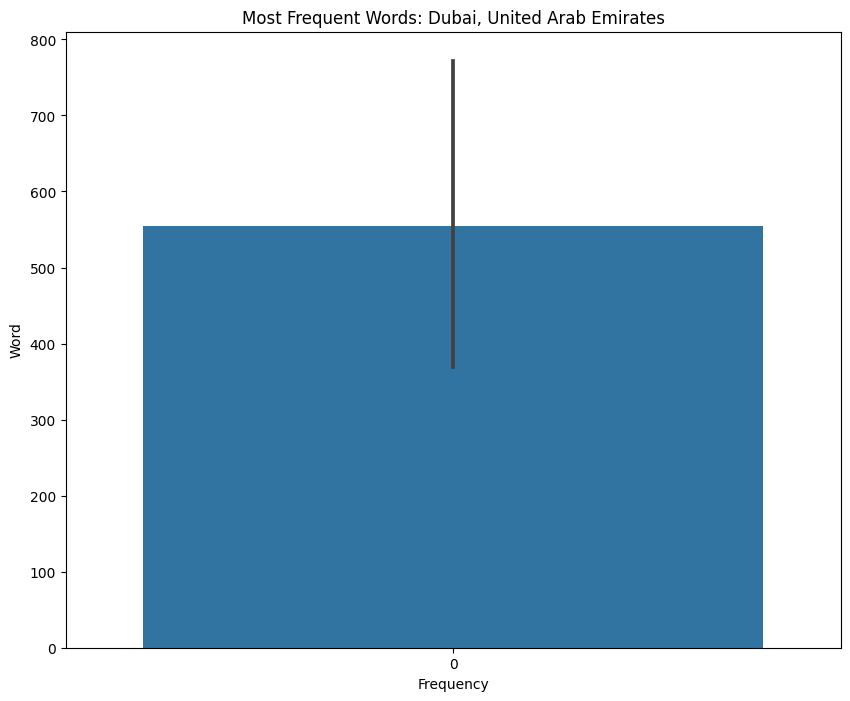

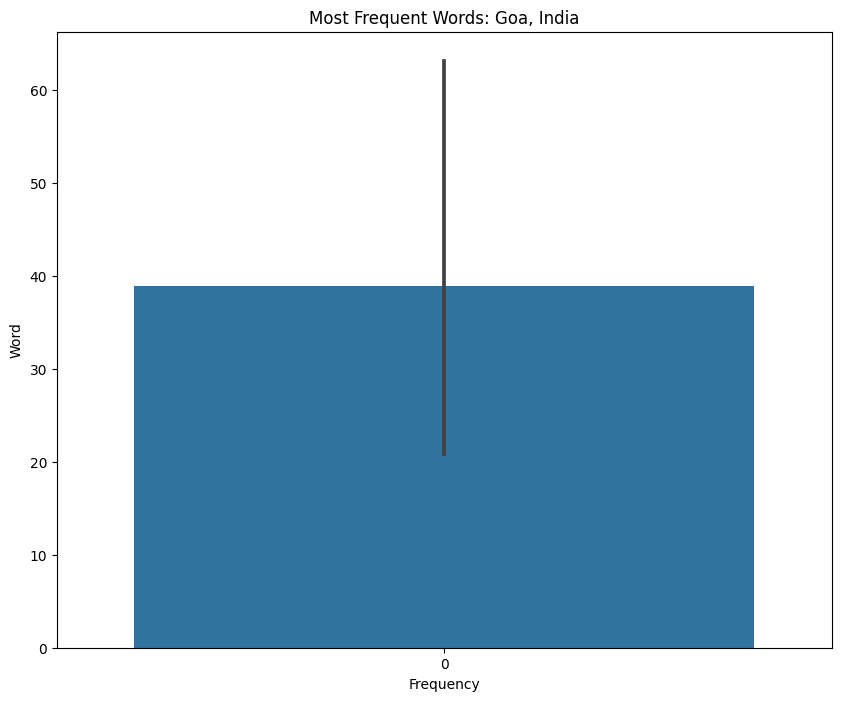

...

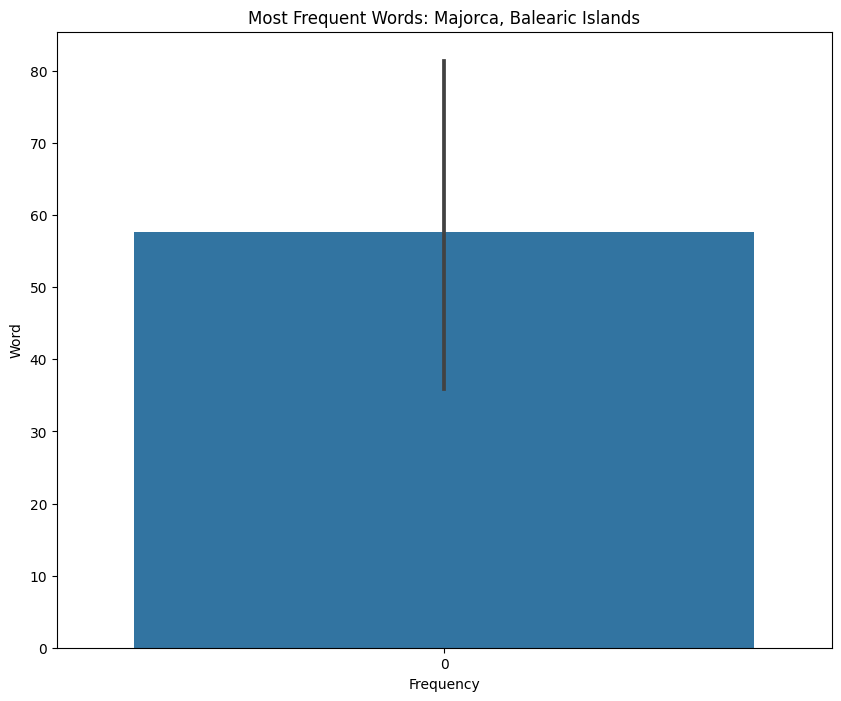

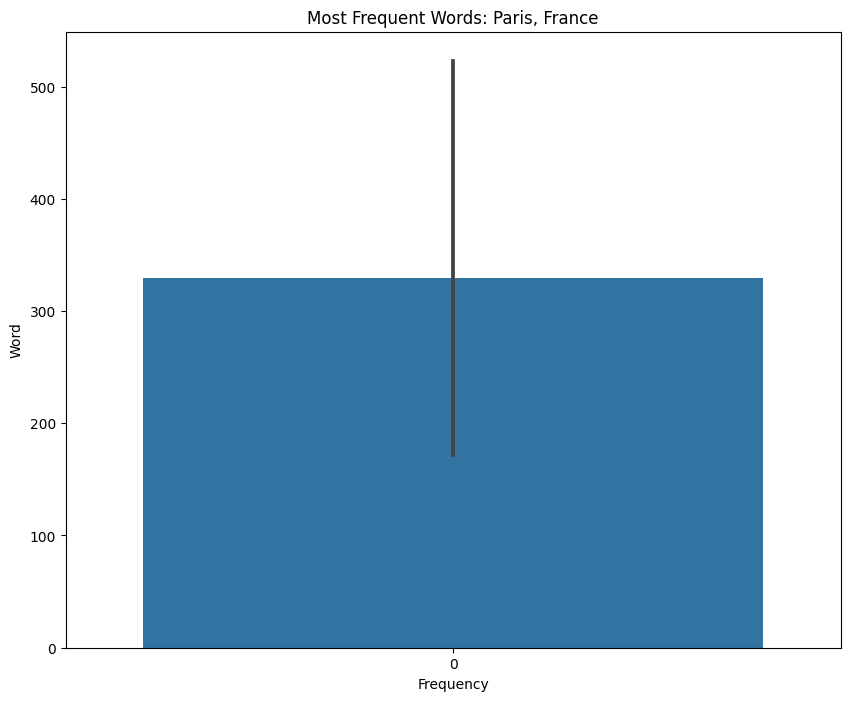

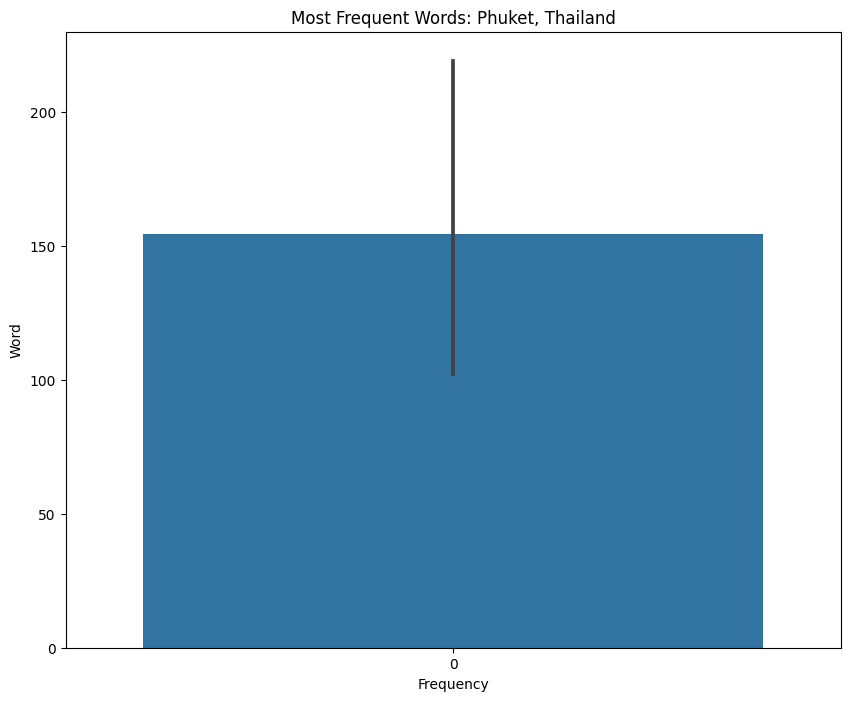

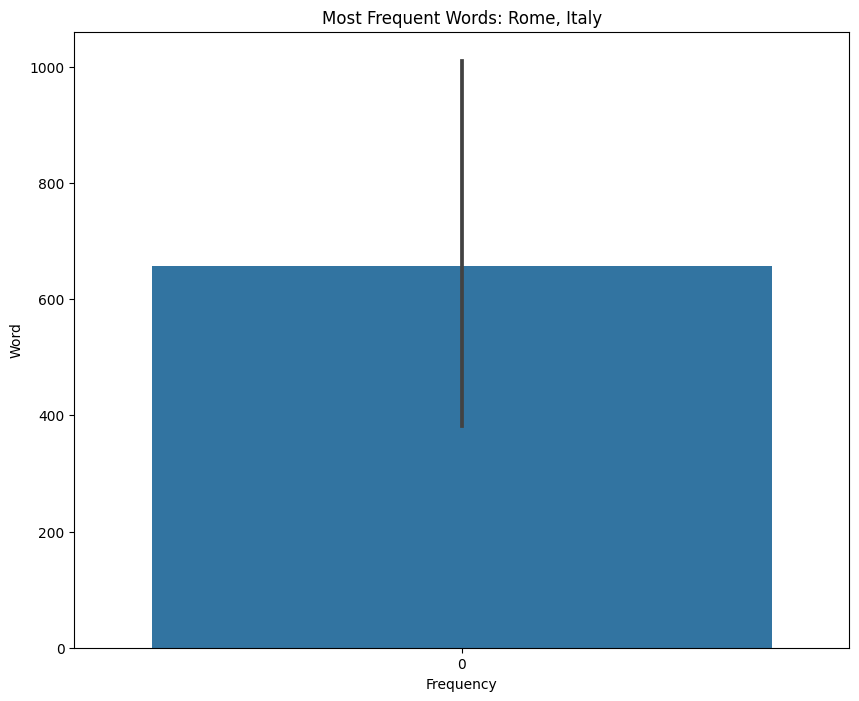

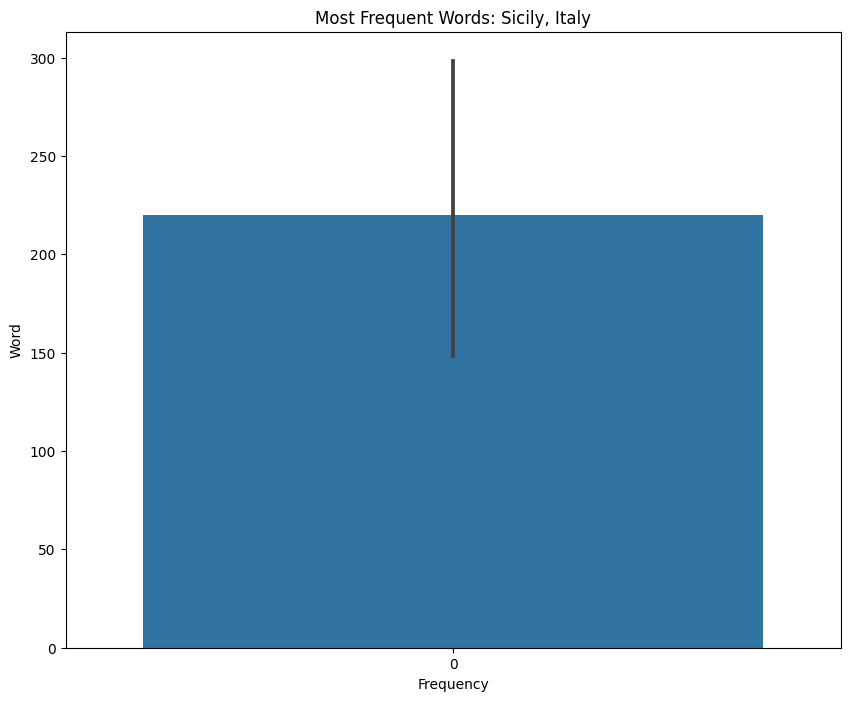

In [95]:
# Make graphs for each city
for city in city_freqs_df.columns:    
    yaxis = [x[0] for x in city_freqs_df[city]]
    xaxis = [x[1] for x in city_freqs_df[city]]

    plt.figure(figsize=(10,8))
    sns.barplot(xaxis)
    plt.title(f'Most Frequent Words: {city}')
    plt.xlabel('Frequency')
    plt.ylabel('Word')
    plt.show()

## Modeling

### Baseline Naive Bayes Model 

In [96]:
# Re-import the data to get a fresh start
data = pd.read_csv('../Data/cities_df', index_col=0)
data.head()

,Attraction,City
0,SEA LIFE London Aquarium Admission Ticket,"London, United Kingdom"
1,The Jack The Ripper Walking Tour in London,"London, United Kingdom"
2,Ghost Bus Tour of London,"London, United Kingdom"
3,Big Bus London Hop-On Hop-Off Tour and River C...,"London, United Kingdom"
4,The Blood and Tears Walk: Serial Killers and L...,"London, United Kingdom"


In [97]:
# Perform train/test split before cleaning/preprocessing
X = data['Attraction']
y = data['City']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2, random_state=123)
X_train.shape, X_test.shape

((22703,), (5676,))

In [98]:
# Since this is a series, I will need to make it a DF for my preprocessing function
X_train

2092           The Colosseum and The Ancient City of Rome
814                              Paintball in Canggu/Bali
1920    9Hr Tour London Eye, Westminster Abbey and St ...
348             Dubai 3h Sea escape: Swim! Tan! Sightsee!
3122    Private Bali Half Day Car Charter - Uluwatu Su...
                              ...                        
1428                Barcelona City + La Roca Village Tour
14      Etna, Wine and Alcantara Tour - Small Groups f...
3345                            Fujiearah East Coast Tour
4210    Early Morning Vatican Museums, Sistine Chapel,...
246             Rafa Nadal Museum Mallorca Half Day Tour 
Name: Attraction, Length: 22703, dtype: object

In [99]:
X_train_preprocessed = preprocess_df(pd.DataFrame(X_train, columns=['Attraction']), 'lemmatized')
X_test_preprocessed = preprocess_df(pd.DataFrame(X_test, columns=['Attraction']), 'lemmatized')

,Attraction,lemmatized
2092,The Colosseum and The Ancient City of Rome,colosseum ancient city rome
814,Paintball in Canggu/Bali,paintball canggubali
1920,"9Hr Tour London Eye, Westminster Abbey and St ...",tour london eye westminster abbey st pauls c...
348,Dubai 3h Sea escape: Swim! Tan! Sightsee!,dubai sea escape swim tan sightsee
3122,Private Bali Half Day Car Charter - Uluwatu Su...,private bali half day car charter uluwatu su...
1313,Rooftop Pasta Making Class and Food Market Tou...,rooftop pasta make class food market tour rome
952,"Colosseum, Forum and Baroque Squares",colosseum forum baroque square
972,Gothic Quarter's deepest secrets & Sangria,gothic quarter deepest secret sangria
1622,Private Half-Day Montserrat Tour in Afternoon ...,private halfday montserrat tour afternoon pi...
1036,Changing of the Guard Half-Day Private Walking...,change guard halfday private walking london tour


,Attraction,lemmatized
302,Phuket City Tour Fullday,phuket city tour fullday
66,Phuket: Guided Fast Track Phuket Airport,phuket guide fast track phuket airport
208,Guided Montserrat Monastery Day Tour with Hot ...,guide montserrat monastery day tour hot air ba...
3846,Private Pizza & Tiramisu Class at a Cesarina's...,private pizza tiramisu class cesarinas home ...
111,Sierra Tramuntana: Mountain Tops and Cosy Vill...,sierra tramuntana mountain top cosy village
1521,Bali Ubud Paon Cooking Class,bali ubud paon cooking class
277,Driver's license free boat rental,driver license free boat rental
230,East bali tour,east bali tour
455,Private Tour: Istanbul Sightseeing Including M...,private tour istanbul sightseeing include muse...
1564,Catania Private Walking Tour,catania private walking tour


In [100]:
stopwords_list = stopwords.words('english')
stopwords_list += list(string.punctuation)
stopwords_list += ['airport', 'transfer', 'private']

In [101]:
# Vectorize the text data to be suitable for modeling
vectorizer = TfidfVectorizer(analyzer='word', stop_words=stopwords_list, decode_error='ignore')
X_train_tfidf = vectorizer.fit_transform(X_train_preprocessed['lemmatized'])
X_test_tfidf = vectorizer.transform(X_test_preprocessed['lemmatized'])

In [102]:
def plot_conf_matrix(y_true, y_pred):
    
    """
    Plots a confusion matrix and displays classification report.
    """
    
    cm = confusion_matrix(y_true, y_pred, normalize='true')
    plt.figure(figsize=(15, 15))
    sns.heatmap(cm, annot=True, cmap='Blues', fmt='0.2g', annot_kws={"size": 14},
                xticklabels=nb.classes_, yticklabels=nb.classes_, square=True)
    plt.xlabel('Predictions')
    plt.ylabel('Actuals')
    plt.show()

In [111]:

def evaluate_model(model, X_train, X_test):
    y_preds_train = model.predict(X_train)
    y_preds_test = model.predict(X_test)

    print('Training Accuracy:', accuracy_score(y_train, y_preds_train))
    print('Testing Accuracy:', accuracy_score(y_test, y_preds_test))
    print('\n---------------\n')
    print('Training F1:', f1_score(y_train, y_preds_train, average='weighted'))
    print('Testing F1:', f1_score(y_test, y_preds_test, average='weighted'))
    #print('\n---------------\n')
    #print('Train Confusion Matrix\n')
    #plot_conf_matrix(y_train, y_preds_train)
    #print('Test Confusion Matrix\n')
    #plot_conf_matrix(y_test, y_preds_test)
    print('\n----------------\n')
    print(classification_report(y_test, y_preds_test))

In [104]:
nb = MultinomialNB()
nb.fit(X_train_tfidf, y_train)

MultinomialNB()

In [105]:
nb.classes_

array(['Bali, Indonesia', 'Barcelona, Spain', 'Crete, Greece',
       'Dubai, United Arab Emirates', 'Goa, India', 'Istanbul, Turkey',
       'London, United Kingdom', 'Majorca, Balearic Islands',
       'Paris, France', 'Phuket, Thailand', 'Rome, Italy',
       'Sicily, Italy'], dtype='<U27')

In [112]:
evaluate_model(nb, X_train_tfidf, X_test_tfidf)

Training Accuracy: 0.9234021935427036
Testing Accuracy: 0.8934108527131783

---------------

Training F1: 0.9190518550599766
Testing F1: 0.8880608573581469

----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.85      0.97      0.90      1001
           Barcelona, Spain       0.96      0.86      0.91       368
              Crete, Greece       1.00      0.64      0.78       244
Dubai, United Arab Emirates       0.91      0.96      0.93       760
                 Goa, India       1.00      0.24      0.38        68
           Istanbul, Turkey       0.97      0.91      0.94       485
     London, United Kingdom       0.93      0.91      0.92       563
  Majorca, Balearic Islands       1.00      0.34      0.50       101
              Paris, France       0.94      0.90      0.92       538
           Phuket, Thailand       0.98      0.80      0.88       212
                Rome, Italy       0.79      0.98      0.88       

**Surprisingly, this model performs pretty well. However, the 3 classes with the lowest accuracy and F1 scores are Goa, Majorca, and Crete. These are also the 3 classes with the least attractions, meaning that class imbalance is definitely affecting this model. We can fix this issue using class weights in the next iteration.**


## Naive Bayes Iteration 2
- Using class weights to improve class imbalance.

In [113]:
# Compute class weights
#class_weights = class_weight.compute_class_weight('balanced',np.unique(y_train),y_train)
class_weights = class_weight.compute_class_weight(class_weight='balanced',
                                     classes=np.unique(y_train),
                                     y=y_train)
weights_dict = dict(zip(np.unique(y_train), class_weights))
weights_dict

{'Bali, Indonesia': 0.4730974410269234,
 'Barcelona, Spain': 1.272304416050213,
 'Crete, Greece': 2.42864783910997,
 'Dubai, United Arab Emirates': 0.6448250397636901,
 'Goa, India': 6.732799525504152,
 'Istanbul, Turkey': 1.038373582144164,
 'London, United Kingdom': 0.8446056547619047,
 'Majorca, Balearic Islands': 5.359537299338999,
 'Paris, France': 0.8795521462885479,
 'Phuket, Thailand': 1.9129592180653858,
 'Rome, Italy': 0.4640462758564304,
 'Sicily, Italy': 1.1891368112298344}

In [114]:
# Use class weights dictionary to calculate sample weight (needed for MultinomialNB)
sample_weights = class_weight.compute_sample_weight(weights_dict, y_train)

In [115]:
nb = MultinomialNB()
nb.fit(X_train_tfidf,y_train,sample_weight=sample_weights)

MultinomialNB()

In [116]:
evaluate_model(nb, X_train_tfidf, X_test_tfidf)

Training Accuracy: 0.9575386512795666
Testing Accuracy: 0.9284707540521494

---------------

Training F1: 0.9580137836254998
Testing F1: 0.9294174036474621

----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.97      0.94      0.95      1001
           Barcelona, Spain       0.89      0.92      0.91       368
              Crete, Greece       0.92      0.88      0.90       244
Dubai, United Arab Emirates       0.95      0.94      0.95       760
                 Goa, India       0.60      0.91      0.73        68
           Istanbul, Turkey       0.95      0.96      0.95       485
     London, United Kingdom       0.93      0.91      0.92       563
  Majorca, Balearic Islands       0.78      0.82      0.80       101
              Paris, France       0.93      0.91      0.92       538
           Phuket, Thailand       0.83      0.95      0.89       212
                Rome, Italy       0.97      0.94      0.96       

**This model did really well! Although, in many of these cities' attractions text, the name of the city is included. This may become an issue in the future because when we introduce new text to this model, it may not include the city name.**

### Iteration 3: What happens if I take the city names out?

In [117]:
new_stopwords = stopwords_list + ['bali', 'barcelona', 'crete', 'dubai',
                                  'istanbul', 'london', 'majorca', 'phuket',
                                  'paris', 'rome', 'sicily', 'mallorca', 'goa']

In [118]:
vectorizer = TfidfVectorizer(analyzer='word',
                             stop_words=new_stopwords,
                             decode_error='ignore')
X_train_tfidf = vectorizer.fit_transform(X_train_preprocessed['lemmatized'])
X_test_tfidf = vectorizer.transform(X_test_preprocessed['lemmatized'])

In [119]:
nb = MultinomialNB()
nb.fit(X_train_tfidf,
       y_train,
       sample_weight=sample_weights)

MultinomialNB()

In [120]:
evaluate_model(nb, X_train_tfidf, X_test_tfidf)

Training Accuracy: 0.8552173721534599
Testing Accuracy: 0.8097251585623678

---------------

Training F1: 0.8584844569845927
Testing F1: 0.8143439972268685

----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.90      0.84      0.87      1001
           Barcelona, Spain       0.70      0.71      0.70       368
              Crete, Greece       0.87      0.82      0.85       244
Dubai, United Arab Emirates       0.88      0.86      0.87       760
                 Goa, India       0.33      0.75      0.46        68
           Istanbul, Turkey       0.76      0.83      0.79       485
     London, United Kingdom       0.81      0.77      0.79       563
  Majorca, Balearic Islands       0.52      0.75      0.62       101
              Paris, France       0.79      0.76      0.77       538
           Phuket, Thailand       0.64      0.76      0.70       212
                Rome, Italy       0.91      0.81      0.86       

In [121]:
# Save the Naive Bayes Model
joblib.dump(nb, '../nb_model')

['../nb_model']

**Much better, because these are more realistic accuracy scores and F1 scores for when we introduce new text to the model.**

## Iteration 4: Try using Count Vectorization 

In [122]:
# Continuing each new iteration without city names 
cv = CountVectorizer(analyzer='word',
                     stop_words=new_stopwords,
                     decode_error='ignore')
X_train_cv = cv.fit_transform(X_train_preprocessed['lemmatized'])
X_test_cv = cv.transform(X_test_preprocessed['lemmatized'])
nb_cv = MultinomialNB()
nb_cv.fit(X_train_cv,
          y_train,
          sample_weight=sample_weights)
evaluate_model(nb_cv, X_train_cv, X_test_cv)

Training Accuracy: 0.8398890014535524
Testing Accuracy: 0.7980972515856237

---------------

Training F1: 0.8442099346733531
Testing F1: 0.8035929831594456

----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.90      0.83      0.86      1001
           Barcelona, Spain       0.67      0.70      0.69       368
              Crete, Greece       0.85      0.81      0.83       244
Dubai, United Arab Emirates       0.88      0.84      0.86       760
                 Goa, India       0.30      0.71      0.42        68
           Istanbul, Turkey       0.73      0.82      0.77       485
     London, United Kingdom       0.79      0.77      0.78       563
  Majorca, Balearic Islands       0.49      0.74      0.59       101
              Paris, France       0.78      0.75      0.76       538
           Phuket, Thailand       0.66      0.74      0.70       212
                Rome, Italy       0.91      0.79      0.85       

**With count vectorization, the scores are very similar, but still a tiny bit lower than with TF-IDF vectorization, therefore We will keep the TF-IDF vectorization strategy.**